# Tipping Points of Ecosystem Functioning

## Arman Ahmadi

## Import Libraries

In [1]:
import numpy as np
import pandas as pd
import os
import glob
import scipy as sp
import sklearn as skl

from google.colab import files

import matplotlib.pyplot as plt
from IPython import display
display.set_matplotlib_formats('svg')

from datetime import datetime

import seaborn as sns
%matplotlib inline

import warnings
warnings.filterwarnings("ignore")

/tmp/ipython-input-1-827768893.py:12: DeprecationWarning: `set_matplotlib_formats` is deprecated since IPython 7.23, directly use `matplotlib_inline.backend_inline.set_matplotlib_formats()`
  display.set_matplotlib_formats('svg')


## Extracting Satellite Data

### Setting Up Google Earth Engine

In [2]:
import ee
import geemap

# Authenticate to my Google Earth Engine account
ee.Authenticate()

# Initialize Earth Engine
ee.Initialize()

MessageError: Error: credential propagation was unsuccessful

### Defining the List of Locations

In [ ]:
points = [
    {'name': 'US-Bi1', 'lat': 38.0992, 'lon': -121.4993},
    {'name': 'US-Ton', 'lat': 38.4309, 'lon': -120.9660},
    # Add more points here
]

# Create a list of point geometries
point_geometries = [ee.Geometry.Point(point['lon'], point['lat']) for point in points]

### Defining the Time Period

In [ ]:
start_date = '2022-01-01'
end_date = '2022-12-31'

### NDVI from Sentinel-2

In [ ]:
# Create a Sentinel-2 image collection filtered by date and bounds
collection = ee.ImageCollection('COPERNICUS/S2') \
    .filterDate(ee.Date(start_date), ee.Date(end_date)) \
    .filter(ee.Filter.lt('CLOUDY_PIXEL_PERCENTAGE', 20)) \
    .filterBounds(ee.FeatureCollection(point_geometries))


# Calculate NDVI for each image in the collection
def calculateNDVI(image):
    ndvi = image.normalizedDifference(['B8', 'B4']).rename('NDVI')
    return image.addBands(ndvi)

collection = collection.map(calculateNDVI)

# Define a time series function to extract NDVI values for a point
def extractTimeSeriesForPoint(point):
    def extract(image):
        date = ee.Date(image.get('system:time_start')).format('yyyy-MM-dd')
        values = image.select('NDVI').reduceRegion(
            reducer=ee.Reducer.first(),
            geometry=point['geometry'],
            scale=10
        )

        # Convert the NDVI value to a Feature
        feature = ee.Feature(None, values).set('date', date)

        return feature

    ndvi_series = collection.map(extract)
    return ndvi_series

# Extract NDVI time series for all points
ndvi_for_points = [extractTimeSeriesForPoint({'geometry': point_geo}) for point_geo in point_geometries]

# Create a Pandas DataFrame for each point's time series
dfs = []
for i, point in enumerate(points):
    data = []
    for feature in ndvi_for_points[i].getInfo()['features']:
        properties = feature['properties']
        date = properties['date']
        ndvi_value = properties['NDVI']
        data.append({'date': date, point['name']: ndvi_value})

    df = pd.DataFrame(data)
    dfs.append(df)

# Merge the DataFrames based on the 'date' column
Sentinel2_NDVI = dfs[0]
for i in range(1, len(dfs)):
    Sentinel2_NDVI = pd.merge(Sentinel2_NDVI, dfs[i], on='date', how='outer')


In [ ]:
Sentinel2_NDVI

,date,US-Bi1,US-Ton
0,2022-01-09,0.519812,0.478368
1,2022-01-14,0.560745,0.479030
2,2022-01-19,0.332613,0.443565
3,2022-01-24,0.560284,0.434029
4,2022-02-08,0.334598,0.227460
5,2022-02-13,0.345300,0.229579
6,2022-02-23,0.353897,0.240437
7,2022-02-28,0.317413,0.259611
8,2022-03-20,0.339020,0.272494
9,2022-03-25,0.411545,0.271321


## Mounting Google Drive

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')
os.chdir('/content/gdrive/MyDrive/Postdoc Research/Tipping Points')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


## Data Processing - Phase 0
### Here we process the excel file containing the information of 135 Ameriflux Fluxnet sites.

### Import Data

In [ ]:
os.chdir('/content/gdrive/MyDrive/Postdoc Research/RS Flux Feature Analysis/Flux Data')

Ameriflux126 = pd.read_csv('Ameriflux_fluxnet_list_126.csv', index_col=None, header=0)

### Data Analysis

In [ ]:
# Changing the columns' names

Ameriflux126.columns = ['SiteID', 'Name', 'PI', 'DataPolicy', 'Ameriflux_Base', 'Ameriflux_Fluxnet',\
                        'IGBP', 'IGBP_Descrp', 'Koppen', 'Koppen_Descrp', 'MAP', 'MAT', 'Country', 'Latitude',\
                        'Longitude', 'Elevation', 'YearsofBase', 'BaseDOI', 'YearsofFluxnet', 'FluxnetDOI',\
                        'SiteStart', 'SiteEnd', 'BaseVar', 'FluxnetVar', 'NumberofYears']

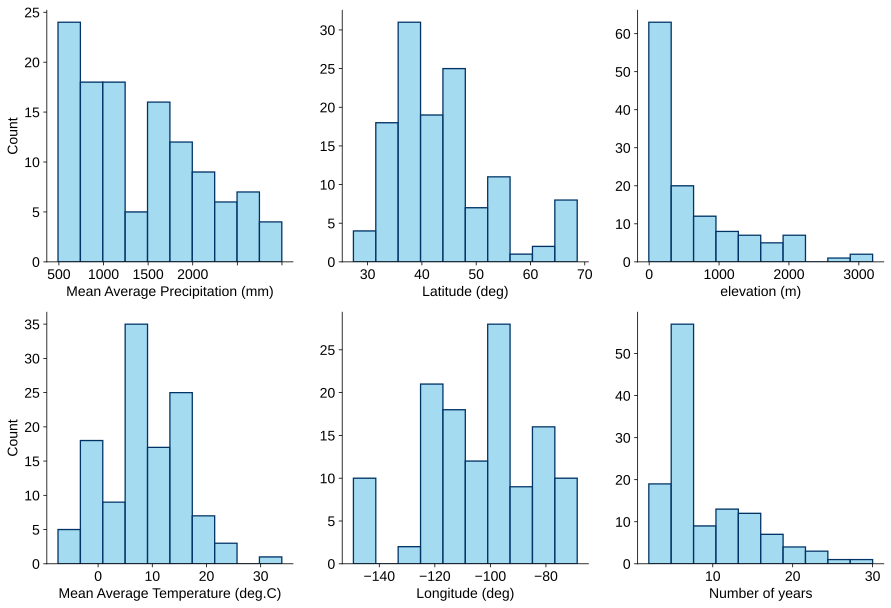

In [ ]:
# Histograms of quantitative variables

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(2,3, figsize=(15,10))

z1 = sns.histplot(Ameriflux126, x='MAP', linewidth=1.3, ax=axes[0,0], color=blue_color, edgecolor=edge_color, bins=10)
z2 = sns.histplot(Ameriflux126, x='MAT', linewidth=1.3, ax=axes[1,0], color=blue_color, edgecolor=edge_color, bins=10)
z3 = sns.histplot(Ameriflux126, x='Latitude', linewidth=1.3, ax=axes[0,1], color=blue_color, edgecolor=edge_color, bins=10)
z4 = sns.histplot(Ameriflux126, x='Longitude', linewidth=1.3, ax=axes[1,1], color=blue_color, edgecolor=edge_color, bins=10)
z5 = sns.histplot(Ameriflux126, x='Elevation', linewidth=1.3, ax=axes[0,2], color=blue_color, edgecolor=edge_color, bins=10)
z6 = sns.histplot(Ameriflux126, x='NumberofYears', linewidth=1.3, ax=axes[1,2], color=blue_color, edgecolor=edge_color, bins=10)


# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel='Mean Average Precipitation (mm)', ylabel='Count')
z2.set(xlabel='Mean Average Temperature (deg.C)', ylabel='Count')
z3.set(xlabel='Latitude (deg)', ylabel=None)
z4.set(xlabel='Longitude (deg)', ylabel=None)
z5.set(xlabel='elevation (m)', ylabel=None)
z6.set(xlabel='Number of years', ylabel=None)

# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.2, style='white')
# plt.tight_layout()



# plt.savefig('Ameriflux126_Distributions.jpg', dpi=400)

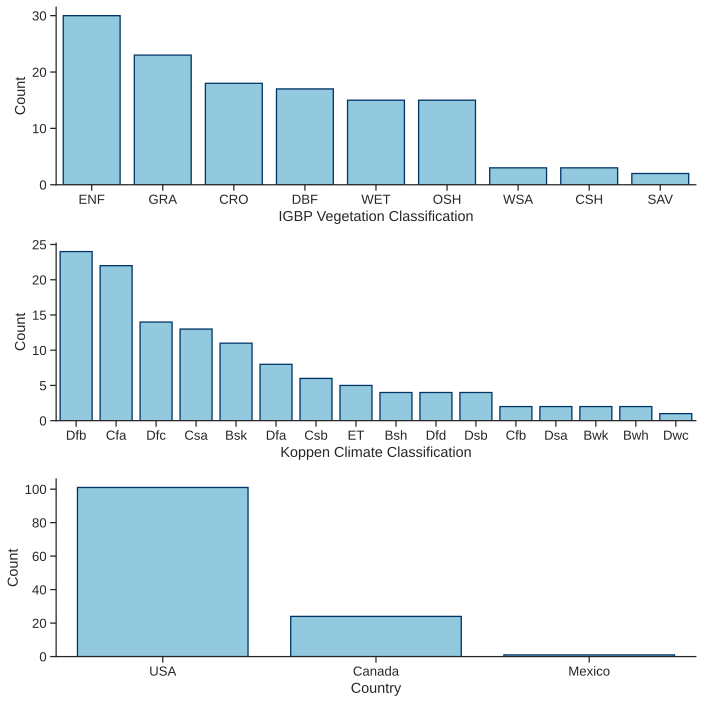

In [ ]:
# Histograms of categorical variables
# Also sort them from higher to lower number of cases

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(3,1, figsize=(10,10))

z1 = sns.countplot(Ameriflux126, x='IGBP', linewidth=1.3, ax=axes[0], color=blue_color, edgecolor=edge_color,\
                   order=Ameriflux126['IGBP'].value_counts().index)
z2 = sns.countplot(Ameriflux126, x='Koppen', linewidth=1.3, ax=axes[1], color=blue_color, edgecolor=edge_color,\
                   order=Ameriflux126['Koppen'].value_counts().index)
z3 = sns.countplot(Ameriflux126, x='Country', linewidth=1.3, ax=axes[2], color=blue_color, edgecolor=edge_color,\
                   order=Ameriflux126['Country'].value_counts().index)

# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel='IGBP Vegetation Classification', ylabel='Count')
z2.set(xlabel='Koppen Climate Classification', ylabel='Count')
z3.set(xlabel='Country', ylabel='Count')

# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.2,style='white')
plt.tight_layout()


# plt.savefig('Ameriflux126_Categorical_Distribution.jpg', dpi=400)

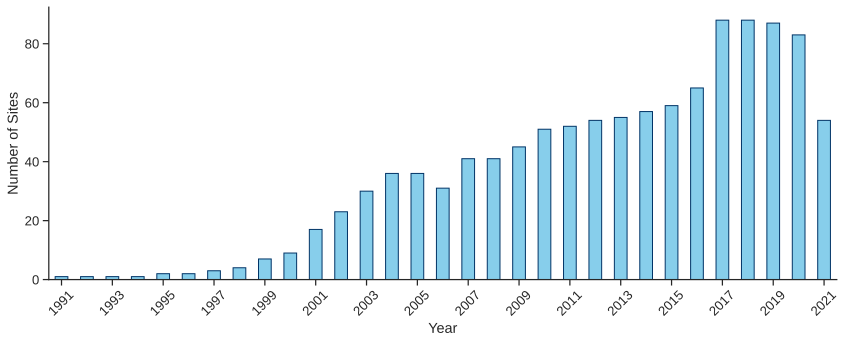

In [ ]:
# Barplot for site-years

# Create a list of years from the earliest "startdate" to 2021
start_year = Ameriflux126['SiteStart'].min()
end_year = 2021  # Current year

years = list(range(start_year, end_year + 1))

# Create a dictionary to store counts for each year
year_counts = {year: 0 for year in years}

# Iterate over each sample in the DataFrame
for index, row in Ameriflux126.iterrows():
    start = row['SiteStart']
    end = row['SiteEnd']

    # Increment the counts for each year within the range
    for year in range(start, end + 1):
        year_counts[year] += 1

# Convert the year_counts dictionary to a Pandas Series
yearly_counts = pd.Series(year_counts)

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

# Create the bar plot
plt.figure(figsize=(12, 5))
yearly_counts.plot(kind='bar', color=blue_color, edgecolor=edge_color)


plt.xlabel('Year')
plt.ylabel('Number of Sites')
plt.xticks(ticks=range(0, len(yearly_counts.index), 2), labels=yearly_counts.index[::2], rotation=45)
plt.tick_params(axis='x', which='both', bottom=True, top=False)
plt.tick_params(axis='y', which='both', left=True, right=False)

# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

plt.tight_layout()
# plt.savefig('Site-Year.jpg', dpi=400)

## Data Importing and Preprocessing

### Import Data

In [ ]:
# path = r'/content/gdrive/MyDrive/Postdoc Research/RS Flux Feature Analysis/Ameriflux FLUXNET/Daily (All)'
# all_files = glob.glob(path + "/*.csv")

# sites = []

# for filename in all_files:
#     df = pd.read_csv(filename, index_col=None, header=0)
#     sites.append(df)

In [ ]:
path = r'/content/gdrive/MyDrive/Postdoc Research/Tipping Points/Daily (Selected)'
all_files = glob.glob(path + "/*.csv")

sites = []

for filename in all_files:
    df = pd.read_csv(filename, index_col=None, header=0)

    # Extract SiteID from the filename (assuming the format is "AMF_XX-XXX_...")
    site_id = filename.split('_')[1]
    # site_id = '-'.join(site_id)

    # Add a new column "SiteID" with the extracted value
    df['SiteID'] = site_id

    sites.append(df)

In [ ]:
Allsites1 = pd.concat(sites, axis=0, ignore_index=True)

In [ ]:
print('Number of daily samples samples: ', len(Allsites1))

Number of daily samples samples:  302636


In [ ]:
# Allsites2 = Allsites1.dropna(subset=['LW_OUT'])

In [ ]:
# print('Number of samples after removing rows containing NAN values for LW_OUT: ', len(Allsites2))

### Data Preparation 1

In [ ]:
# # Selecting a subset of useful columns for data analysis

# sites_sub1 = []

# for i in range(len(sites)):
#   sites_sub1.append(sites[i][['TIMESTAMP','siteID','Koeppen', 'IGBP', 'MAT_longterm',\
#                            'MAP_longterm', 'latitude', 'longitude', 'elevation',\
#                            'country', 'TA_F', 'SW_IN_F', 'VPD_F', 'P_F',\
#                            'WS_F', 'CO2_F_MDS', 'LE_F_MDS', 'H_F_MDS',\
#                               'GPP_NT_VUT_REF', 'GPP_DT_VUT_REF',\
#                               'ET', 'WUE']])

In [ ]:
Allsites2 = Allsites1[['TIMESTAMP', 'SiteID', 'TA_F', 'SW_IN_F', 'LW_IN_F', 'LW_OUT', 'VPD_F', 'P_F',\
                           'WS_F', 'CO2_F_MDS', 'LE_F_MDS', 'H_F_MDS',\
                              'GPP_NT_VUT_REF', 'GPP_DT_VUT_REF']]

In [ ]:
# # Renaming the columns

# for i in range(len(sites_sub1)):
#   sites_sub1[i].columns = ['Time', 'SiteID', 'Koppen', 'IGBP', 'MAT',\
#                         'MAP', 'latitude', 'longitude', 'elevation',\
#                         'country', 'T_air', 'SW', 'VPD', 'precipitation',\
#                         'WS', 'CO2', 'LE', 'H',\
#                            'GPP_night', 'GPP_day',\
#                            'ET_Koong', 'WUE_Koong']

In [ ]:
Allsites2.columns = ['TimeStamp', 'SiteID', 'T_air', 'SW', 'LW_In', 'LW_Out', 'VPD', 'precipitation',\
                        'WS', 'CO2', 'LE', 'H',\
                           'GPP_night', 'GPP_day']
pd.DataFrame

pandas.core.frame.DataFrame

In [ ]:
# # Concatenating all sites

# Allsites = pd.concat(sites_sub1, axis=0, ignore_index=True)

### Including Data from May to Sep Only

In [ ]:
Allsites2['TimeStamp'] = pd.to_datetime(Allsites2['TimeStamp'], format='%Y%m%d')

In [ ]:
mask = (Allsites2['TimeStamp'].dt.month >= 5) & (Allsites2['TimeStamp'].dt.month <= 9)

In [ ]:
Allsites3 = Allsites2[mask]

In [ ]:
# Only for considering the full year data

Allsites3 = Allsites2

### Data Cleaning

In [ ]:
print('Number of samples before removing rows containing NAN or negative/zero values: ', len(Allsites3))

Number of samples before removing rows containing NAN or negative/zero values:  302636


In [ ]:
# Removing samples with NAN for LE or GPP

Allsites3 = Allsites3.dropna(subset = ['LE', 'GPP_day', 'GPP_night'])


# Removing samples with negative/zero values for LE or GPP

Allsites3 = Allsites3[(~Allsites3[['LE', 'GPP_day', 'GPP_night']].lt(0).any(axis=1)) &\
                    (~Allsites3[['LE', 'GPP_day', 'GPP_night']].eq(0).any(axis=1))]

In [ ]:
print('Number of samples after removing rows containing NAN or negative/zero values: ', len(Allsites3))

Number of samples after removing rows containing NAN or negative/zero values:  236670


In [ ]:
# Removing samples with negative/zero values for T_air

Allsites3 = Allsites3[(~Allsites3[['T_air']].lt(0).any(axis=1)) &\
                      (~Allsites3[['T_air']].eq(0).any(axis=1))]

In [ ]:
print('Number of samples after removing rows containing negative/zero values for T_air: ', len(Allsites3))

Number of samples after removing rows containing negative/zero values for T_air:  207729


In [ ]:
# # Adding day-night column

# Allsites3['day-night'] = Allsites3.GPP_day - Allsites3.GPP_night

In [ ]:
# # Adding daily ET column (mm/day)


# # Calculating latent heat of vaporization (MJ/kg)
# Allsites3['Lv'] = 2.501 - 0.00236 * Allsites3.T_air


# # Calculating ET (mm/day)
# Allsites3['ET'] = ((24*60*60)/(1000000)) * (Allsites3.LE / Allsites3.Lv)

In [ ]:
# # Converting VPD to kPa instead of hPa

# Allsites3['VPD_kPa'] = Allsites3.VPD * 0.1

In [ ]:
# # Adding water use efficiency (kgC/m^3)

# Allsites['WUE'] = Allsites.GPP_day / Allsites.ET

In [ ]:
# Changing the units of SW radiation

Allsites3['SW_MJ'] = Allsites3.SW * ((3600*24)/1000000)

In [ ]:
# Adding evaporative fraction

Allsites3['EF'] = Allsites3.LE / (Allsites3.LE + Allsites3.H)

### Including Information from Ameriflux_191

In [ ]:
os.chdir('/content/gdrive/MyDrive/Postdoc Research/Tipping Points')

Ameriflux191 = pd.read_csv('Ameriflux_fluxnet_list_191.csv', index_col=None, header=0)

In [ ]:
# sites_in_allsites = set(Allsites3['SiteID'])
# sites_in_ameriflux191 = set(Ameriflux191['SiteID'])

# missing_sites = sites_in_allsites - sites_in_ameriflux191
# print("SiteIDs in Allsites but not in Ameriflux191:")
# print(missing_sites)

In [ ]:
# Merge the two DataFrames based on 'SiteID'

merging_columns = ['SiteID','IGBP', 'Koppen', 'MAP',\
                  'MAT', 'Country', 'Latitude', 'Longitude',\
                  'Elevation', 'Wetness_Index']
Allsites = pd.merge(Allsites3, Ameriflux191[merging_columns], on='SiteID', how='left')

In [ ]:
# print('Number of samples before removing unwanted IGBPs: ', len(Allsites))

In [ ]:
# # Removing Unwanted IGBPs

# values_to_drop = ['CVM', 'MF', 'SNO', 'WAT']
# Allsites = Allsites[~Allsites['IGBP'].isin(values_to_drop)]

In [ ]:
# print('Number of samples after removing unwanted IGBPs: ', len(Allsites))

### Combining IGBP and Climate Classes

IGBP:

- WSA and SAV combined and called SAV

- CSH and OSH combined and called SHR


Climate:

- Humid continental: Dfb, Dfa, Dsb, Dsa

- Humid subtropical: Cfa

- Subarctic: Dfc, Dfd, Dwc

- Mediterranean: Csa, Csb

- Semi-arid: Bsk, Bsh

- Tundra: ET

- Oceanic: Cfb

- Arid: BWk, BWh

In [ ]:
Allsites['PFT'] = Allsites['IGBP'].replace({'WSA': 'SAV', 'SAV': 'SAV', 'CSH': 'SHR', 'OSH': 'SHR'})

In [ ]:
Allsites['PFT'].unique()

array(['WET', 'SHR', 'GRA', 'DBF', 'ENF', 'CRO', 'SAV'], dtype=object)

In [ ]:
Allsites['Climate'] = Allsites['Koppen'].replace({'Dfb': 'HC', 'Dfa': 'HC', 'Dsb': 'HC', 'Dsa': 'HC',\
                                                  'Cfa': 'HS', 'Dfc': 'S', 'Dfd': 'S', 'Dwc': 'S',\
                                                  'Csa': 'M', 'Csb': 'M', 'Bsk': 'SA', 'Bsh': 'SA',\
                                                  'ET': 'T', 'Cfb': 'O', 'Bwk': 'A', 'Bwh': 'A'})

In [ ]:
Allsites['Climate'].unique()

array(['HS', 'T', 'SA', 'HC', 'M', 'S'], dtype=object)

### Data Preparation 2

Here, we remove the upper and lower 2.5% of the data for ET and GPP, but for each site specifically.

In [ ]:
# # Create an empty DataFrame to store the filtered results
# filtered_data = pd.DataFrame()

# for site_id in Allsites['SiteID'].unique():
#     Data = Allsites[Allsites['SiteID'] == site_id]

#     # Calculate upper and lower bounds for each site
#     upper_ET = Data['ET'].quantile(0.975)
#     lower_ET = Data['ET'].quantile(0.025)
#     upper_GPP = Data['GPP_day'].quantile(0.975)
#     lower_GPP = Data['GPP_day'].quantile(0.025)
#     upper_GPP_N = Data['GPP_night'].quantile(0.975)
#     lower_GPP_N = Data['GPP_night'].quantile(0.025)

#     # Filter the values for each site within the upper and lower bounds
#     filtered = Data[(Data['ET'] <= upper_ET) & (Data['ET'] >= lower_ET) &
#                     (Data['GPP_day'] <= upper_GPP) & (Data['GPP_day'] >= lower_GPP) &
#                     (Data['GPP_night'] <= upper_GPP_N) & (Data['GPP_night'] >= lower_GPP_N)]

#     # Append the filtered data for each site
#     filtered_data = pd.concat([filtered_data, filtered])

# # Update Allsites with the filtered data
# Allsites = filtered_data

In [ ]:
# print('Number of samples after removing upper and lower 2.5% of ET and GPP values: ', len(Allsites))

In [ ]:
# Removing samples with negative/zero values for CO2

Allsites = Allsites[(~Allsites[['CO2']].lt(0).any(axis=1)) &\
                    (~Allsites[['CO2']].eq(0).any(axis=1))]

In [ ]:
print('Number of samples after removing zero and negative CO2 values: ', len(Allsites))

Number of samples after removing zero and negative CO2 values:  205712


In [ ]:
# # Removing samples with negative/zero values for LW_Out

# Allsites = Allsites[(~Allsites[['LW_Out']].lt(0).any(axis=1)) &\
#                     (~Allsites[['LW_Out']].eq(0).any(axis=1))]

In [ ]:
# print('Number of samples after removing zero and negative LW_Out values: ', len(Allsites))

Here, we remove the upper and lower 2.5% of the data for CO2, but for each site specifically.

In [ ]:
# # Create an empty DataFrame to store the filtered results
# filtered_data = pd.DataFrame()

# for site_id in Allsites['SiteID'].unique():
#     Data = Allsites[Allsites['SiteID'] == site_id]

#     # Calculate upper and lower bounds for each site
#     upper_CO2 = Data['CO2'].quantile(0.975)
#     lower_CO2 = Data['CO2'].quantile(0.025)

#     # Filter the values for each site within the upper and lower bounds
#     filtered = Data[(Data['CO2'] <= upper_CO2) & (Data['CO2'] >= lower_CO2)]

#     # Append the filtered data for each site
#     filtered_data = pd.concat([filtered_data, filtered])

# # Update Allsites with the filtered data
# Allsites = filtered_data

In [ ]:
# print('Number of samples after removing upper and lower 2.5% of CO2 values: ', len(Allsites))

Here we remove the lower 2.5% of the data for air temperature, site specifically.

In [ ]:
# # Create an empty DataFrame to store the filtered results
# filtered_data = pd.DataFrame()

# for site_id in Allsites['SiteID'].unique():
#     Data = Allsites[Allsites['SiteID'] == site_id]

#     # Calculate lower bounds for each site
#     lower_Tair = Data['T_air'].quantile(0.025)

#     # Filter the values for each site within the upper and lower bounds
#     filtered = Data[(Data['T_air'] >= lower_Tair)]

#     # Append the filtered data for each site
#     filtered_data = pd.concat([filtered_data, filtered])

# # Update Allsites with the filtered data
# Allsites = filtered_data

In [ ]:
# print('Number of samples after removing lower 2.5% of T_air values: ', len(Allsites))

In [ ]:
# Allsites = Allsites[Allsites.LW_Out < 550]

In [ ]:
# print('Number of samples after removing unexpectedly large values of LW_Out: ', len(Allsites))

In [ ]:
Allsites = Allsites[Allsites.CO2 < 700]

In [ ]:
print('Number of samples after removing unexpectedly large values of CO2: ', len(Allsites))

Number of samples after removing unexpectedly large values of CO2:  203560


### Adding Maximum Daily Air Temperature form Half-hourly Data

In [ ]:
# Iterate through unique site IDs in Allsites DataFrame
for site_id in Allsites['SiteID'].unique():
    # Construct the filename for the half-hourly CSV file
    filename = f'/content/gdrive/MyDrive/Postdoc Research/Tipping Points/Hourly (matched)/AMF_{site_id}.csv'

    # Read the half-hourly data for the current site
    half_hourly_data = pd.read_csv(filename)

    # Extract necessary columns
    half_hourly_data['TIMESTAMP_START'] = pd.to_datetime(half_hourly_data['TIMESTAMP_START'], format='%Y%m%d%H%M')
    half_hourly_data['TIMESTAMP_END'] = pd.to_datetime(half_hourly_data['TIMESTAMP_END'], format='%Y%m%d%H%M')

    # Group by "TimeStamp" and find the maximum daily air temperature
    max_temp_per_day = half_hourly_data.groupby(half_hourly_data['TIMESTAMP_START'].dt.date)['TA_F_MDS'].max()

    # Create a new DataFrame with "TimeStamp" and "Max_T_air" columns
    max_temp_df = pd.DataFrame({'TimeStamp': max_temp_per_day.index, 'Max_T_air': max_temp_per_day.values})

    # Merge the result back into Allsites DataFrame based on "TimeStamp" and the current site ID
    Allsites.loc[Allsites['SiteID'] == site_id, 'Max_T_air'] = Allsites['TimeStamp'].map(max_temp_df.set_index('TimeStamp')['Max_T_air'])


In [ ]:
Allsites = Allsites[Allsites.Max_T_air < 45]

In [ ]:
print('Number of samples after removing unexpectedly large values of Max_T_air: ', len(Allsites))

Number of samples after removing unexpectedly large values of Max_T_air:  0


In [ ]:
# Removing samples with negative EF

Allsites = Allsites[Allsites.EF > 0]

In [ ]:
# Removing samples with EF values higher than 1.4

Allsites = Allsites[Allsites.EF <= 1.4]

In [ ]:
print('Number of samples after removing bad EF values: ', len(Allsites))

Number of samples after removing bad EF values:  186042


In [ ]:
# # Exploring sites with negative EF

# data = Allsites[(Allsites.EF<0) & (-5<Allsites.EF)]

# fig, ax = plt.subplots(figsize=(10, 7))

# plt.scatter(data['SW'], data['EF'], alpha=0.7)

# # Add labels and title
# plt.xlabel('Shortwave Radiation (W m-2)')
# plt.ylabel('Evaporative Fraction')
# # plt.title('1 < WI')


# plt.tight_layout()


# # plt.savefig('EF_SW.jpg', dpi=400)

## Data Processing - Phase 1
### Here we process the data from Ameriflux Fluxnet sites.


### GPP_day vs. GPP_night Scatterplots

In [ ]:
from sklearn.metrics import r2_score

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(3,3, figsize=(18,12))

################################################################################
data = Allsites[Allsites.PFT=='ENF']

z1 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[0,0], color=blue_color, edgecolor=edge_color)

z1_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[0,0])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z1.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.PFT=='DBF']

z2 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[0,1], color=blue_color, edgecolor=edge_color)

z2_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[0,1])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z2.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.PFT=='SAV']

z3 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[0,2], color=blue_color, edgecolor=edge_color)

z3_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[0,2])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z3.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.PFT=='SHR']

z4 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[1,0], color=blue_color, edgecolor=edge_color)

z4_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[1,0])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z4.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.PFT=='GRA']

z5 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[1,1], color=blue_color, edgecolor=edge_color)

z5_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[1,1])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z5.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.PFT=='CRO']

z6 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[1,2], color=blue_color, edgecolor=edge_color)

z6_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[1,2])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z6.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.PFT=='WET']

z7 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[2,0], color=blue_color, edgecolor=edge_color)

z7_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[2,0])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z7.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
empty_ax1 = plt.subplot(3, 3, 8)
empty_ax1.axis('off')  # Turn off axis for the empty subplot
empty_ax2 = plt.subplot(3, 3, 9)
empty_ax2.axis('off')  # Turn off axis for the empty subplot

# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel=None, ylabel='GPP from Nighttime method', title='Evergreen Needleleaf Forests')
z2.set(xlabel=None, ylabel=None, title='Deciduous Broadleaf Forests')
z3.set(xlabel=None, ylabel=None, title='Savannas')
z4.set(xlabel=None, ylabel='GPP from Nighttime method', title='Shrublands')
z5.set(xlabel='GPP from Daytime method', ylabel=None, title='Grasslands')
z6.set(xlabel='GPP from Daytime method', ylabel=None, title='Croplands')
z7.set(xlabel='GPP from Daytime method', ylabel='GPP from Nighttime method', title='Wetlands')

# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.25,style='white')
plt.tight_layout()


# plt.savefig('GPP_DT_Vs_NT_ScatterPlot_PFT.jpg', dpi=400)
plt.close()

In [ ]:
from sklearn.metrics import r2_score

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(3,3, figsize=(18,12))

################################################################################
data = Allsites[Allsites.Climate=='HC']

z1 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[0,0], color=blue_color, edgecolor=edge_color)

z1_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[0,0])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z1.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.Climate=='HS']

z2 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[0,1], color=blue_color, edgecolor=edge_color)

z2_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[0,1])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z2.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.Climate=='S']

z3 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[0,2], color=blue_color, edgecolor=edge_color)

z3_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[0,2])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z3.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.Climate=='M']

z4 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[1,0], color=blue_color, edgecolor=edge_color)

z4_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[1,0])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z4.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.Climate=='SA']

z5 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[1,1], color=blue_color, edgecolor=edge_color)

z5_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[1,1])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z5.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.Climate=='T']

z6 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[1,2], color=blue_color, edgecolor=edge_color)

z6_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[1,2])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z6.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.Climate=='O']

z7 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[2,0], color=blue_color, edgecolor=edge_color)

z7_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[2,0])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z7.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
data = Allsites[Allsites.Climate=='A']

z8 = sns.scatterplot(data=data, x= 'GPP_day', y= 'GPP_night', ax=axes[2,1], color=blue_color, edgecolor=edge_color)

z8_1 = sns.lineplot(x=[data['GPP_day'].min(), data['GPP_day'].max()],
         y=[data['GPP_night'].min(), data['GPP_night'].max()],
         linestyle='-', color='red',ax=axes[2,1])

x = data['GPP_day']
y = data['GPP_night']
slope, intercept = np.polyfit(x, y, 1)
r_squared = r2_score(y, slope * x + intercept)

z8.annotate(f'R^2 = {r_squared:.2f}', xy=(0.05, 0.95), xycoords='axes fraction',
            ha='left', va='top', bbox=dict(boxstyle='round,pad=0.4', fc='white', alpha=0.7))
################################################################################
empty_ax2 = plt.subplot(3, 3, 9)
empty_ax2.axis('off')  # Turn off axis for the empty subplot

# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel=None, ylabel='GPP from Nighttime method', title='Humid Continental')
z2.set(xlabel=None, ylabel=None, title='Humid Subtropical')
z3.set(xlabel=None, ylabel=None, title='Subarctic')
z4.set(xlabel=None, ylabel='GPP from Nighttime method', title='Mediterranean')
z5.set(xlabel=None, ylabel=None, title='Semi-aird')
z6.set(xlabel='GPP from Daytime method', ylabel=None, title='Tundra')
z7.set(xlabel='GPP from Daytime method', ylabel='GPP from Nighttime method', title='Oceanic')
z8.set(xlabel='GPP from Daytime method', ylabel=None, title='Arid')

# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.25,style='white')
plt.tight_layout()


# plt.savefig('GPP_DT_Vs_NT_ScatterPlot_Climate.jpg', dpi=400)
plt.close()

### (GPP_day - GPP_night) histograms

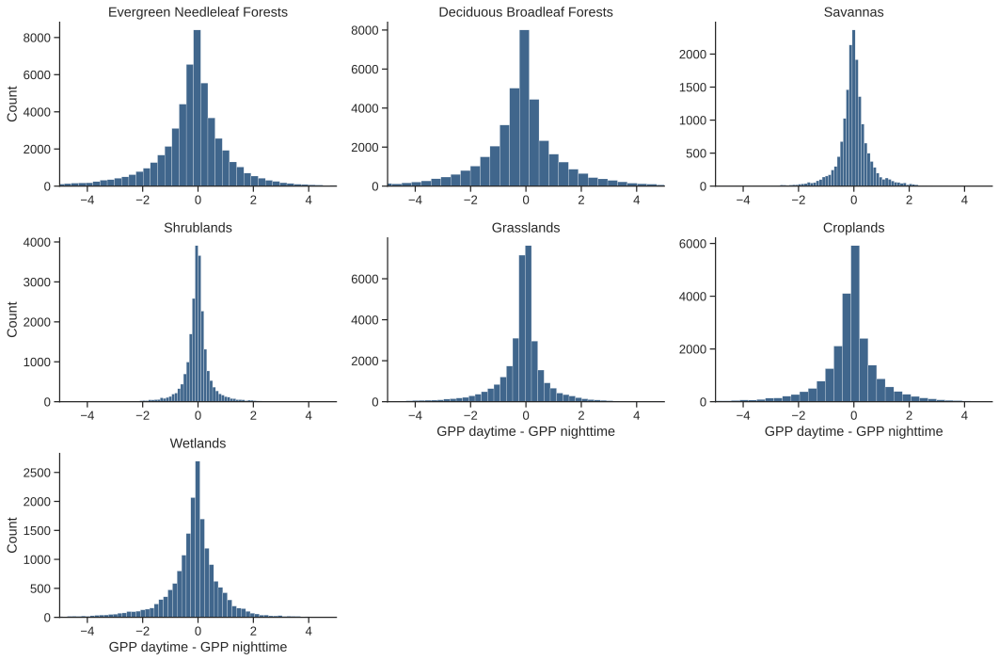

In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(3,3, figsize=(15,10))

################################################################################
data = Allsites[Allsites.PFT=='ENF']

z1 = sns.histplot(data=data, x= 'day-night', ax=axes[0,0], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.PFT=='DBF']

z2 = sns.histplot(data=data, x= 'day-night', ax=axes[0,1], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.PFT=='SAV']

z3 = sns.histplot(data=data, x= 'day-night', ax=axes[0,2], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.PFT=='SHR']

z4 = sns.histplot(data=data, x= 'day-night', ax=axes[1,0], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.PFT=='GRA']

z5 = sns.histplot(data=data, x= 'day-night', ax=axes[1,1], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.PFT=='CRO']

z6 = sns.histplot(data=data, x= 'day-night', ax=axes[1,2], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.PFT=='WET']

z7 = sns.histplot(data=data, x= 'day-night', ax=axes[2,0], color = edge_color, bins=100)
################################################################################
empty_ax = plt.subplot(3, 3, 8)
empty_ax.axis('off')  # Turn off axis for the empty subplot

empty_ax = plt.subplot(3, 3, 9)
empty_ax.axis('off')  # Turn off axis for the empty subplot



z1.set(xlabel=None, ylabel='Count', title='Evergreen Needleleaf Forests', xlim=(-5,5))
z2.set(xlabel=None, ylabel=None, title='Deciduous Broadleaf Forests', xlim=(-5,5))
z3.set(xlabel=None, ylabel=None, title='Savannas', xlim=(-5,5))
z4.set(xlabel=None, ylabel='Count', title='Shrublands', xlim=(-5,5))
z5.set(xlabel='GPP daytime - GPP nighttime', ylabel=None, title='Grasslands', xlim=(-5,5))
z6.set(xlabel='GPP daytime - GPP nighttime', ylabel=None, title='Croplands', xlim=(-5,5))
z7.set(xlabel='GPP daytime - GPP nighttime', ylabel='Count', title='Wetlands', xlim=(-5,5))

# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.2,style='white')
plt.tight_layout()


# plt.savefig('GPP_DT_minus_NT_histograms_PFT.jpg', dpi=400)

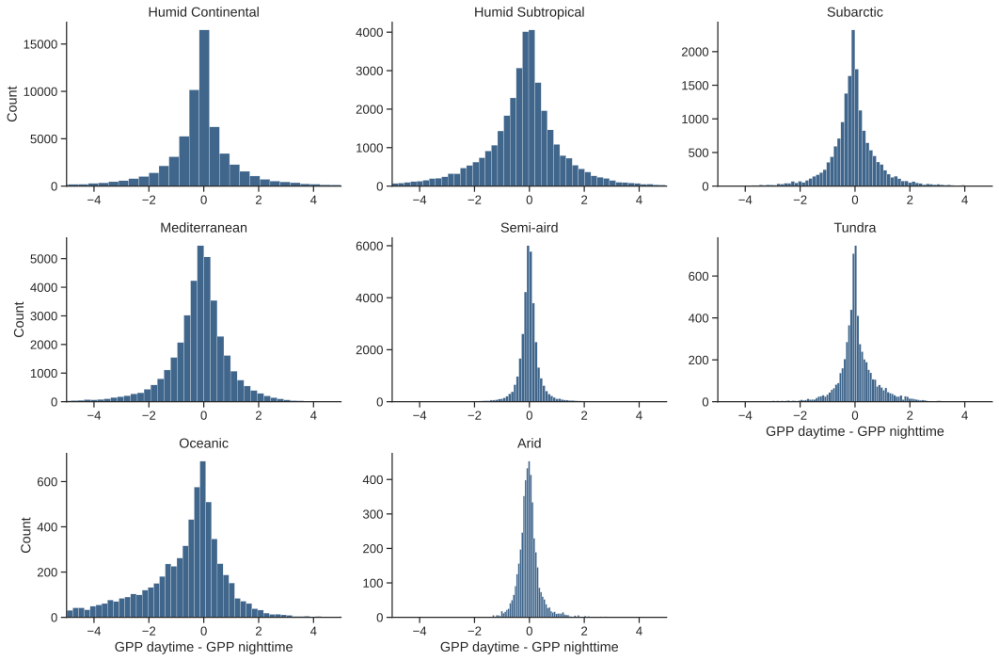

In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(3,3, figsize=(15,10))

################################################################################
data = Allsites[Allsites.Climate=='HC']

z1 = sns.histplot(data=data, x= 'day-night', ax=axes[0,0], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.Climate=='HS']

z2 = sns.histplot(data=data, x= 'day-night', ax=axes[0,1], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.Climate=='S']

z3 = sns.histplot(data=data, x= 'day-night', ax=axes[0,2], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.Climate=='M']

z4 = sns.histplot(data=data, x= 'day-night', ax=axes[1,0], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.Climate=='SA']

z5 = sns.histplot(data=data, x= 'day-night', ax=axes[1,1], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.Climate=='T']

z6 = sns.histplot(data=data, x= 'day-night', ax=axes[1,2], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.Climate=='O']

z7 = sns.histplot(data=data, x= 'day-night', ax=axes[2,0], color = edge_color, bins=100)
################################################################################
data = Allsites[Allsites.Climate=='A']

z8 = sns.histplot(data=data, x= 'day-night', ax=axes[2,1], color = edge_color, bins=100)
################################################################################
empty_ax = plt.subplot(3, 3, 9)
empty_ax.axis('off')  # Turn off axis for the empty subplot



z1.set(xlabel=None, ylabel='Count', title='Humid Continental', xlim=(-5,5))
z2.set(xlabel=None, ylabel=None, title='Humid Subtropical', xlim=(-5,5))
z3.set(xlabel=None, ylabel=None, title='Subarctic', xlim=(-5,5))
z4.set(xlabel=None, ylabel='Count', title='Mediterranean', xlim=(-5,5))
z5.set(xlabel=None, ylabel=None, title='Semi-aird', xlim=(-5,5))
z6.set(xlabel='GPP daytime - GPP nighttime', ylabel=None, title='Tundra', xlim=(-5,5))
z7.set(xlabel='GPP daytime - GPP nighttime', ylabel='Count', title='Oceanic', xlim=(-5,5))
z8.set(xlabel='GPP daytime - GPP nighttime', ylabel=None, title='Arid', xlim=(-5,5))

# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.2,style='white')
plt.tight_layout()


# plt.savefig('GPP_DT_minus_NT_histograms_Climate.jpg', dpi=400)

### Distribution of ET and GPP (BoxPlots)

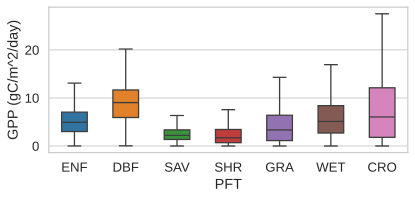

In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

f, axes = plt.subplots(1,1, figsize=(6,3))

desired_order = ['ENF', 'DBF', 'SAV', 'SHR', 'GRA', 'WET', 'CRO']

# Define a distinct and suitable color palette for all eleven categories

palette_8 = [
    '#1f77b4',  # Blue
    '#ff7f0e',  # Orange
    '#2ca02c',  # Green
    '#d62728',  # Red
    '#9467bd',  # Purple
    '#8c564b',  # Brown
    '#e377c2',  # Pink
    '#bcbd22',  # Olive
]



z1 = sns.boxplot(data = Allsites, x = 'PFT', y = 'GPP_day', order = desired_order, palette=palette_8, \
                 linewidth=1.3, showfliers = False, width=0.5)

# z2 = sns.boxplot(data = Allsites, x = 'PFT', y = 'GPP_day', order = desired_order, \
#                  linewidth=1.3, ax=axes[1], palette=palette_8, showfliers = False, width=0.5)

# z3 = sns.boxplot(data = Allsites, x = 'IGBP', y = 'WUE', order = desired_order, \
#                  linewidth=1.3, ax=axes[2], palette=palette_11, showfliers = False, width=0.5)


# z1.axes.get_xaxis().set_visible(False)
# z2.axes.get_xaxis().set_visible(False)

# z1.axes.set_ylabel('ET (mm/day)')
z1.axes.set_ylabel('GPP (gC/m^2/day)')
# z3.axes.set_ylabel('WUE (kgC/m^3)')


sns.set(font_scale=1.2,style='whitegrid')
plt.tight_layout()

# plt.savefig('GPP_boxplots_PFT.jpg', dpi=400)

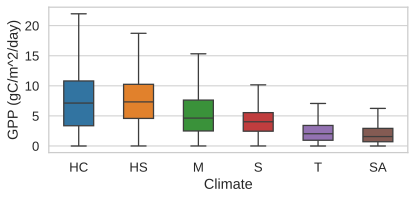

In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

f, axes = plt.subplots(1,1, figsize=(6,3))


desired_order = ['HC', 'HS', 'M', 'S', 'T', 'SA']

# Define a distinct and suitable color palette for all eleven categories

palette_8 = [
    '#1f77b4',  # Blue
    '#ff7f0e',  # Orange
    '#2ca02c',  # Green
    '#d62728',  # Red
    '#9467bd',  # Purple
    '#8c564b',  # Brown
    '#e377c2',  # Pink
    '#bcbd22',  # Olive
]



z1 = sns.boxplot(data = Allsites, x = 'Climate', y = 'GPP_day', order = desired_order, palette=palette_8, \
                 linewidth=1.3, showfliers = False, width=0.5)

# z2 = sns.boxplot(data = Allsites, x = 'Climate', y = 'GPP_day', order = desired_order, \
#                  linewidth=1.3, ax=axes[1], palette=palette_8, showfliers = False, width=0.5)

# z3 = sns.boxplot(data = Allsites, x = 'IGBP', y = 'WUE', order = desired_order, \
#                  linewidth=1.3, ax=axes[2], palette=palette_11, showfliers = False, width=0.5)


# z1.axes.get_xaxis().set_visible(False)
# z2.axes.get_xaxis().set_visible(False)

# z1.axes.set_ylabel('ET (mm/day)')
z1.axes.set_ylabel('GPP (gC/m^2/day)')
# z3.axes.set_ylabel('WUE (kgC/m^3)')


sns.set(font_scale=1.2,style='whitegrid')
plt.tight_layout()

# plt.savefig('GPP_boxplots_Climate.jpg', dpi=400)

### Meteorological Variables Boxplots

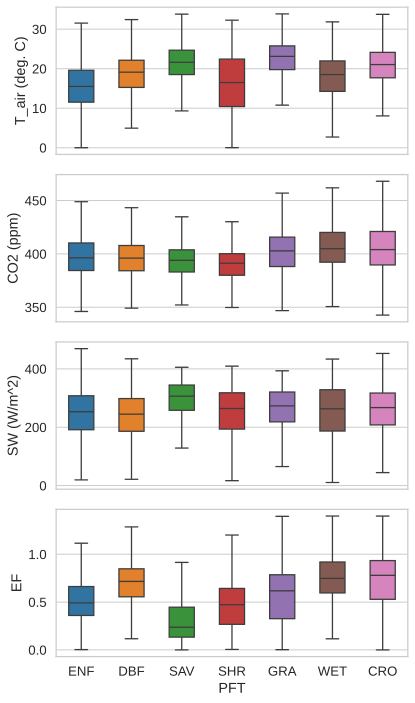

In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

palette_8 = [
    '#1f77b4',  # Blue
    '#ff7f0e',  # Orange
    '#2ca02c',  # Green
    '#d62728',  # Red
    '#9467bd',  # Purple
    '#8c564b',  # Brown
    '#e377c2',  # Pink
    '#bcbd22',  # Olive
]

f, axes = plt.subplots(4,1, figsize=(6,10))

desired_order = ['ENF', 'DBF', 'SAV', 'SHR', 'GRA', 'WET', 'CRO']

z1 = sns.boxplot(data = Allsites, x = 'PFT', y = 'T_air', order = desired_order, \
                 linewidth=1.3, ax=axes[0], palette=palette_8, showfliers = False, width=0.5)

z2 = sns.boxplot(data = Allsites, x = 'PFT', y = 'CO2', order = desired_order, \
                 linewidth=1.3, ax=axes[1], palette=palette_8, showfliers = False, width=0.5)

z3 = sns.boxplot(data = Allsites, x = 'PFT', y = 'SW', order = desired_order, \
                 linewidth=1.3, ax=axes[2], palette=palette_8, showfliers = False, width=0.5)

z4 = sns.boxplot(data = Allsites, x = 'PFT', y = 'EF', order = desired_order, \
                 linewidth=1.3, ax=axes[3], palette=palette_8, showfliers = False, width=0.5)

# z5 = sns.boxplot(data = Allsites, x = 'IGBP', y = 'CO2', order = desired_order, \
#                  linewidth=1.3, ax=axes[4], palette=palette_11, showfliers = False, width=0.5)

z1.axes.get_xaxis().set_visible(False)
z2.axes.get_xaxis().set_visible(False)
z3.axes.get_xaxis().set_visible(False)
# z4.axes.get_xaxis().set_visible(False)

z1.axes.set_ylabel('T_air (deg. C)')
z2.axes.set_ylabel('CO2 (ppm)')
z3.axes.set_ylabel('SW (W/m^2)')
z4.axes.set_ylabel('EF')
# z5.axes.set_ylabel('CO2 (umolCO2/mol)')

sns.set(font_scale=1.2,style='whitegrid')
plt.tight_layout()

# plt.savefig('PFT_boxplots.jpg', dpi=400)

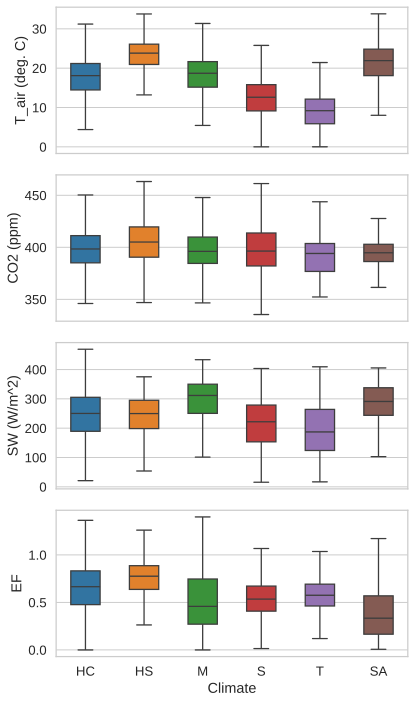

In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

palette_8 = [
    '#1f77b4',  # Blue
    '#ff7f0e',  # Orange
    '#2ca02c',  # Green
    '#d62728',  # Red
    '#9467bd',  # Purple
    '#8c564b',  # Brown
    '#e377c2',  # Pink
    '#bcbd22',  # Olive
]

f, axes = plt.subplots(4,1, figsize=(6,10))

desired_order = ['HC', 'HS', 'M', 'S', 'T', 'SA']

z1 = sns.boxplot(data = Allsites, x = 'Climate', y = 'T_air', order = desired_order, \
                 linewidth=1.3, ax=axes[0], palette=palette_8, showfliers = False, width=0.5)

z2 = sns.boxplot(data = Allsites, x = 'Climate', y = 'CO2', order = desired_order, \
                 linewidth=1.3, ax=axes[1], palette=palette_8, showfliers = False, width=0.5)

z3 = sns.boxplot(data = Allsites, x = 'Climate', y = 'SW', order = desired_order, \
                 linewidth=1.3, ax=axes[2], palette=palette_8, showfliers = False, width=0.5)

z4 = sns.boxplot(data = Allsites, x = 'Climate', y = 'EF', order = desired_order, \
                 linewidth=1.3, ax=axes[3], palette=palette_8, showfliers = False, width=0.5)

# z5 = sns.boxplot(data = Allsites, x = 'IGBP', y = 'CO2', order = desired_order, \
#                  linewidth=1.3, ax=axes[4], palette=palette_11, showfliers = False, width=0.5)

z1.axes.get_xaxis().set_visible(False)
z2.axes.get_xaxis().set_visible(False)
z3.axes.get_xaxis().set_visible(False)
# z4.axes.get_xaxis().set_visible(False)

z1.axes.set_ylabel('T_air (deg. C)')
z2.axes.set_ylabel('CO2 (ppm)')
z3.axes.set_ylabel('SW (W/m^2)')
z4.axes.set_ylabel('EF')
# z5.axes.set_ylabel('CO2 (umolCO2/mol)')

sns.set(font_scale=1.2,style='whitegrid')
plt.tight_layout()

# plt.savefig('Climate_boxplots.jpg', dpi=400)

### The Number of Samples

In [ ]:
Input_Samples_PFT = Allsites.groupby('PFT').agg(Samples=('PFT', 'size'), Sites=('SiteID', 'nunique')).reset_index()

desired_order = ['ENF', 'DBF', 'SAV', 'SHR', 'GRA', 'WET', 'CRO']

Input_Samples_PFT['PFT'] = pd.Categorical(Input_Samples_PFT['PFT'], categories=desired_order, ordered=True)

Input_Samples_PFT = Input_Samples_PFT.sort_values(by='PFT')

In [ ]:
Input_Samples_PFT

,PFT,Samples,Sites
2,ENF,30360,28
1,DBF,23355,16
4,SAV,8527,4
5,SHR,11525,12
3,GRA,14010,14
6,WET,13074,19
0,CRO,11832,15


In [ ]:
Input_Samples_Climate = Allsites.groupby('Climate').agg(Samples=('Climate', 'size'), Sites=('SiteID', 'nunique')).reset_index()

desired_order = ['HC', 'HS', 'M', 'S', 'T', 'SA' ]

Input_Samples_Climate['Climate'] = pd.Categorical(Input_Samples_Climate['Climate'], categories=desired_order, ordered=True)

Input_Samples_Climate = Input_Samples_Climate.sort_values(by='Climate')

In [ ]:
Input_Samples_Climate

,Climate,Samples,Sites
0,HC,39025,34
1,HS,19486,22
2,M,18187,15
3,S,13863,19
5,T,3719,5
4,SA,18403,13


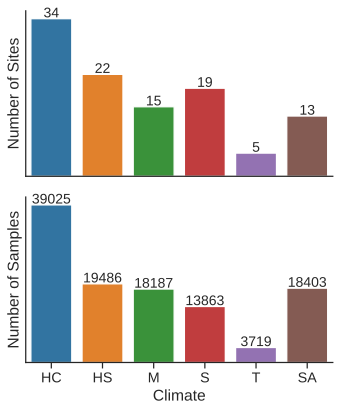

In [ ]:
# Barplots of the number of samples

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

palette_8 = [
    '#1f77b4',  # Blue
    '#ff7f0e',  # Orange
    '#2ca02c',  # Green
    '#d62728',  # Red
    '#9467bd',  # Purple
    '#8c564b',  # Brown
    '#e377c2',  # Pink
    '#bcbd22',  # Olive
]

f, axes = plt.subplots(2,1, figsize=(5,6))

z1 = sns.barplot(data = Input_Samples_Climate, x = 'Climate', y = 'Sites', \
                 linewidth=1.3, ax=axes[0], palette=palette_8)

z2 = sns.barplot(data = Input_Samples_Climate, x = 'Climate', y = 'Samples', \
                 linewidth=1.3, ax=axes[1], palette=palette_8)

# Function to add labels to each bar
def add_bar_labels(ax):
    for p in ax.patches:
        ax.annotate(f"{int(p.get_height())}", (p.get_x() + p.get_width() / 2., p.get_height()),\
                    ha='center', va='center', xytext=(0, 5), textcoords='offset points')


# Add labels to the bars in both subplots
add_bar_labels(z1)
add_bar_labels(z2)

z1.axes.get_xaxis().set_visible(False)

z1.axes.set_ylabel('Number of Sites')
z2.axes.set_ylabel('Number of Samples')

# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='y', which='both', left=True, right=False)
    ax.tick_params(axis='y', which='both', left=False, right=False)
    ax.set_yticks([])

# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.3,style='white')
plt.tight_layout()

# plt.savefig('Samples_and_Sites_number_Climate.jpg', dpi=400)

## Data Processing - Phase 1.1

 Here we use correlation and feature importance analysis and data visaluzation to explore the dynamics of our data

 (This section is not updated and is based on categorizations)

### Pearson Correlation

In [ ]:
# Making data ready for visualization

# from scipy import stats

PCData = Allsites[['PFT', 'Climate', 'MAT',\
                        'MAP', 'Latitude', 'Longitude', 'Elevation',\
                         'T_air', 'SW_MJ', 'VPD_kPa',\
                        'WS', 'CO2', 'LE', 'H',\
                            'GPP_day', 'Max_T_air', 'LW_Out',\
                           'ET']]

PC_var = ['GPP_day', 'T_air', 'Max_T_air', 'LW_Out', 'VPD_kPa']

PC_total = np.zeros((5, 5))

for i, igbp_category in enumerate(['HC', 'HS', 'S', 'M', 'SA']):
    subset_data = PCData[PCData['Climate'] == igbp_category][PC_var]
    correlations = np.array(subset_data.corr()['GPP_day'])
    # p_values = np.array([stats.pearsonr(subset_data[var], subset_data['GPP_day'])[1] for var in PC_var])
    PC_total[:, i] = correlations
    # PC_total[6:, i] = p_values

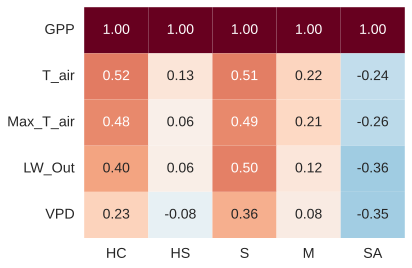

In [ ]:
# Visualizing the heatmap

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

plt.figure(figsize=(6,4))
ylabels = ['GPP', 'T_air', 'Max_T_air', 'LW_Out', 'VPD']
xlabels = ['HC', 'HS','S', 'M', 'SA']

z1 = sns.heatmap(PC_total, annot=True, yticklabels=ylabels, xticklabels=xlabels,\
                 cmap='RdBu_r', fmt='.2f', center = 0, cbar = False)

plt.xticks(rotation='horizontal')
plt.yticks(rotation='horizontal')

sns.set(font_scale=1.3,style='white')
plt.tight_layout()

# plt.savefig('Pearson_correlation_Climate.jpg', dpi=400)

### Mutual Information

In [ ]:
from sklearn.feature_selection import mutual_info_regression

In [ ]:
# Mutual information for each ecosystem class

MIData = Allsites[['PFT', 'Climate', 'MAT',\
                        'MAP', 'Latitude', 'Longitude', 'Elevation',\
                         'T_air', 'SW_MJ', 'VPD_kPa',\
                        'WS', 'CO2', 'LE', 'H',\
                            'GPP_day', 'Max_T_air', 'LW_Out',\
                           'ET']]

MI_var = ['T_air', 'Max_T_air', 'LW_Out', 'VPD_kPa']

MI_classes = [ [ None ] * 4 ] * 5

for i, igbp_category in enumerate(['HC', 'HS','S', 'M', 'SA']):
    X = MIData[MIData.Climate==igbp_category][MI_var]
    y = MIData[MIData.Climate==igbp_category][['GPP_day']]
    MI_classes[i] = skl.feature_selection.mutual_info_regression(X,y)

MI_classes =np.array(MI_classes).reshape((5, 4)).transpose()

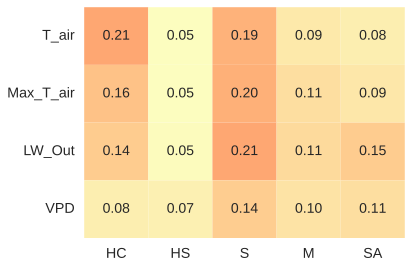

In [ ]:
# Visualizing the heatmap

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

plt.figure(figsize=(6,4))
ylabels = ['T_air', 'Max_T_air', 'LW_Out', 'VPD']
xlabels = ['HC', 'HS','S', 'M', 'SA']

z1 = sns.heatmap(MI_classes, annot=True, yticklabels=ylabels, xticklabels=xlabels,\
                 cmap='magma_r', fmt='.2f', center = 0.5,  cbar = False)

plt.xticks(rotation='horizontal')
plt.yticks(rotation='horizontal')

sns.set(font_scale=1.3,style='white')
plt.tight_layout()

# plt.savefig('Mutual_Info_Climate.jpg', dpi=400)

### Spearman's Correlation

In [ ]:
# Making data ready for visualization

PCData = Allsites[['PFT', 'Climate', 'MAT',\
                        'MAP', 'Latitude', 'Longitude', 'Elevation',\
                         'T_air', 'SW_MJ', 'VPD_kPa',\
                        'WS', 'CO2', 'LE', 'H',\
                            'GPP_day', 'Max_T_air', 'LW_Out',\
                           'ET']]

PC_var = ['GPP_day', 'T_air', 'Max_T_air', 'LW_Out', 'VPD_kPa']

PC_total = np.zeros((5, 5))

for i, igbp_category in enumerate(['HC', 'HS','S', 'M', 'SA']):
    subset_data = PCData[PCData['Climate'] == igbp_category][PC_var]
    correlations = np.array(subset_data.corr(method='spearman')['GPP_day'])
    PC_total[:, i] = correlations

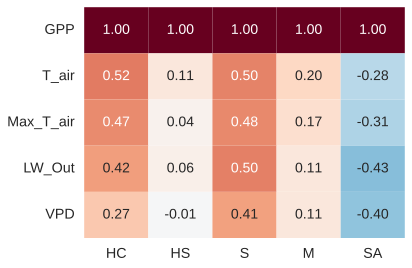

In [ ]:
# Visualizing the heatmap

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

plt.figure(figsize=(6,4))
ylabels = ['GPP', 'T_air', 'Max_T_air', 'LW_Out', 'VPD']
xlabels = ['HC', 'HS','S', 'M', 'SA']

z1 = sns.heatmap(PC_total, annot=True, yticklabels=ylabels, xticklabels=xlabels,\
                 cmap='RdBu_r', fmt='.2f', center = 0, cbar = False)

plt.xticks(rotation='horizontal')
plt.yticks(rotation='horizontal')

sns.set(font_scale=1.3,style='white')
plt.tight_layout()

# plt.savefig('Spearman_correlation_Climate.jpg', dpi=400)

### Scatter and Hex Plots

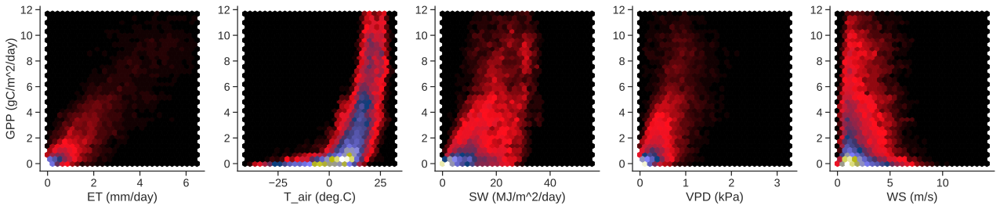

In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

f, axes = plt.subplots(1,5, figsize=(18,4))

# desired_order = ['ENF', 'DBF', 'MF', 'WSA', 'SAV', 'CSH', 'OSH', 'GRA',\
#                  'CVM', 'CRO', 'WET']

data = Allsites[Allsites.IGBP=='WET']

y_min = data['GPP_day'].min()
y_max = data['GPP_day'].max()
################################################################################
x_min = data['ET'].min()
x_max = data['ET'].max()

hb = axes[0].hexbin(data=data, x= 'ET', y= 'GPP_day', gridsize=30, cmap='gist_stern', extent=(x_min, x_max, y_min, y_max))

# cb = plt.colorbar(hb, ax=axes[0])
# cb.set_label('Counts')

axes[0].set_xlabel('ET (mm/day)')
axes[0].set_ylabel('GPP (gC/m^2/day)')
################################################################################
x_min = data['T_air'].min()
x_max = data['T_air'].max()

hb = axes[1].hexbin(data=data, x= 'T_air', y= 'GPP_day', gridsize=30, cmap='gist_stern', extent=(x_min, x_max, y_min, y_max))

# cb = plt.colorbar(hb, ax=axes[1])
# cb.set_label('Counts')

axes[1].set_xlabel('T_air (deg.C)')
################################################################################
x_min = data['SW_MJ'].min()
x_max = data['SW_MJ'].max()

hb = axes[2].hexbin(data=data, x= 'SW_MJ', y= 'GPP_day', gridsize=30, cmap='gist_stern', extent=(x_min, x_max, y_min, y_max))

# cb = plt.colorbar(hb, ax=axes[2])
# cb.set_label('Counts')

axes[2].set_xlabel('SW (MJ/m^2/day)')
################################################################################
x_min = data['VPD_kPa'].min()
x_max = data['VPD_kPa'].max()

hb = axes[3].hexbin(data=data, x= 'VPD_kPa', y= 'GPP_day', gridsize=30, cmap='gist_stern', extent=(x_min, x_max, y_min, y_max))

# cb = plt.colorbar(hb, ax=axes[3])
# cb.set_label('Counts')

axes[3].set_xlabel('VPD (kPa)')
################################################################################
x_min = data['WS'].min()
x_max = data['WS'].max()

hb = axes[4].hexbin(data=data, x= 'WS', y= 'GPP_day', gridsize=30, cmap='gist_stern', extent=(x_min, x_max, y_min, y_max))

# cb = plt.colorbar(hb, ax=axes[4])
# cb.set_label('Counts')

axes[4].set_xlabel('WS (m/s)')
################################################################################
# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')


# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.3,style='white')
plt.tight_layout()


# plt.savefig('Hexbin_GPP_WET.jpg', dpi=400)

## Data Processing - Phase 2

Here e use MI, Pearson, and Spearman correlation for each site

### Generating the dataframe of correlations

In [ ]:
# # Finding the missing site(s)

# missing_site = pd.DataFrame({'new_sites': Allsites.SiteID.unique()})
# missing_site['old_sites'] =  Ameriflux126.SiteID

# missing_value = set(missing_site['old_sites']) - set(missing_site['new_sites'])

# missing_value

In [ ]:
# os.chdir('/content/gdrive/MyDrive/Postdoc Research/RS Flux Feature Analysis/Flux Data')

# Ameriflux125 = pd.read_csv('Ameriflux_fluxnet_list_125.csv', index_col=None, header=0)

In [ ]:
# # Changing the columns' names

# Ameriflux125.columns = ['SiteID', 'Name', 'PI', 'DataPolicy', 'Ameriflux_Base', 'Ameriflux_Fluxnet',\
#                         'IGBP', 'IGBP_Descrp', 'Koppen', 'Koppen_Descrp', 'MAP', 'MAT', 'Country', 'Latitude',\
#                         'Longitude', 'Elevation', 'YearsofBase', 'BaseDOI', 'YearsofFluxnet', 'FluxnetDOI',\
#                         'SiteStart', 'SiteEnd', 'BaseVar', 'FluxnetVar', 'NumberofYears']

In [ ]:
# site_corrs = Ameriflux125[['SiteID', 'IGBP', 'Koppen', 'MAP', 'MAT', 'Latitude', 'Elevation']]

In [ ]:
# site_corrs['PFT'] = site_corrs['IGBP'].replace({'WSA': 'SAV', 'SAV': 'SAV', 'CSH': 'SHR', 'OSH': 'SHR'})

# site_corrs['Climate'] = site_corrs['Koppen'].replace({'Dfb': 'HC', 'Dfa': 'HC', 'Dsb': 'HC', 'Dsa': 'HC',\
#                                                   'Cfa': 'HS', 'Dfc': 'S', 'Dfd': 'S', 'Dwc': 'S',\
#                                                   'Csa': 'M', 'Csb': 'M', 'Bsk': 'SA', 'Bsh': 'SA',\
#                                                   'ET': 'T', 'Cfb': 'O', 'Bwk': 'A', 'Bwh': 'A'})

In [ ]:
site_corrs1 = Allsites[['SiteID', 'PFT', 'Climate', 'MAP', 'MAT', 'Latitude', 'Elevation', 'Wetness_Index']]

site_corrs = site_corrs1.drop_duplicates(subset='SiteID').reset_index(drop=True)

In [ ]:
site_corrs

,SiteID,PFT,Climate,MAP,MAT,Latitude,Elevation,Wetness_Index
0,CA-ARB,WET,HC,700.00,-1.30,52.6950,90.0,0.9337
1,CA-ARF,WET,HC,700.00,-1.30,52.7008,88.0,0.9234
2,CA-DBB,WET,M,1128.00,10.00,49.1293,4.0,1.5075
3,US-ALQ,WET,HC,NaN,NaN,46.0308,NaN,0.9080
4,US-Tw1,WET,M,421.00,15.50,38.1074,-5.0,0.2172
5,US-Tw4,WET,M,421.00,15.60,38.1027,-5.0,0.2167
6,US-WPT,WET,HC,849.00,10.10,41.4646,175.0,0.7619
7,CA-Cbo,DBF,HC,876.34,6.66,44.3167,120.0,0.9560
8,CA-LP1,ENF,M,570.00,2.00,55.1119,751.0,0.8811
9,CA-Qfo,ENF,S,962.32,-0.36,49.6925,382.0,1.3811


In [ ]:
# Pearson correlation

PC_var = ['GPP_day', 'T_air', 'Max_T_air','LW_Out', 'VPD_kPa']

PC_total = np.zeros((5, 54))

for i, site in enumerate(site_corrs.SiteID):
  subset_data = Allsites[Allsites['SiteID'] == site][PC_var]
  correlations = np.array(subset_data.corr()['GPP_day'])
  PC_total[:, i] = correlations


In [ ]:
# Spearman correlation

PC_var = ['GPP_day', 'T_air', 'Max_T_air','LW_Out', 'VPD_kPa']

PC_total = np.zeros((5, 54))

for i, site in enumerate(site_corrs.SiteID):
  subset_data = Allsites[Allsites['SiteID'] == site][PC_var]
  correlations = np.array(subset_data.corr(method='spearman')['GPP_day'])
  PC_total[:, i] = correlations


In [ ]:
from sklearn.feature_selection import mutual_info_regression

In [ ]:
MI_var = ['T_air', 'Max_T_air','LW_Out', 'VPD_kPa']

MI_classes = [ [ None ] * 4 ] * 54

for i, site in enumerate(site_corrs.SiteID):
    X = Allsites[Allsites.SiteID==site][MI_var]
    y = Allsites[Allsites.SiteID==site][['GPP_day']]
    MI_classes[i] = skl.feature_selection.mutual_info_regression(X,y)

MI_classes =np.array(MI_classes).reshape((54, 4)).transpose()

In [ ]:
# Adding the results to site_corrs

new_column_names = ["SC_GPP_GPP", "SC_GPP_Tair", "SC_GPP_MaxTair", "SC_GPP_LWOut", "SC_GPP_VPD"]

new_df = pd.DataFrame(PC_total.T, columns=new_column_names)

site_corrs = pd.concat([site_corrs, new_df], axis=1)

In [ ]:
# Storing site_corrs

csv_path = '/content/gdrive/MyDrive/Postdoc Research/Tipping Points/site_corrs_data.csv'
site_corrs.to_csv(csv_path, index=False)

### Visualizations

In [ ]:
# Importing site_corrs

os.chdir('/content/gdrive/MyDrive/Postdoc Research/Tipping Points')

site_corrs = pd.read_csv('site_corrs_data.csv', index_col=None, header=0)

In [ ]:
site_corrs

,SiteID,PFT,Climate,MAP,MAT,Latitude,Elevation,Wetness_Index,MI_GPP_Tair,MI_GPP_MaxTair,...,PC_GPP_GPP,PC_GPP_Tair,PC_GPP_MaxTair,PC_GPP_LWOut,PC_GPP_VPD,SC_GPP_GPP,SC_GPP_Tair,SC_GPP_MaxTair,SC_GPP_LWOut,SC_GPP_VPD
0,CA-ARB,WET,HC,700.00,-1.30,52.6950,90.0,0.9337,0.350069,0.274425,...,1.0,0.617089,0.560995,0.646908,0.355122,1.0,0.599841,0.542847,0.638399,0.422709
1,CA-ARF,WET,HC,700.00,-1.30,52.7008,88.0,0.9234,0.368359,0.293794,...,1.0,0.622799,0.578605,0.660695,0.431660,1.0,0.620209,0.575302,0.667104,0.475760
2,CA-DBB,WET,M,1128.00,10.00,49.1293,4.0,1.5075,0.110188,0.124103,...,1.0,0.319760,0.178988,0.445999,0.221098,1.0,0.328698,0.192946,0.440023,0.265843
3,US-ALQ,WET,HC,NaN,NaN,46.0308,NaN,0.9080,0.249471,0.250410,...,1.0,0.572338,0.615774,0.634265,0.441691,1.0,0.574967,0.631233,0.642640,0.476777
4,US-Tw1,WET,M,421.00,15.50,38.1074,-5.0,0.2172,0.166319,0.086433,...,1.0,0.378146,0.314220,0.257114,0.138144,1.0,0.339185,0.275046,0.247202,0.154433
5,US-Tw4,WET,M,421.00,15.60,38.1027,-5.0,0.2167,0.116174,0.127716,...,1.0,0.236095,0.207099,0.164595,0.151364,1.0,0.258219,0.213111,0.226370,0.199580
6,US-WPT,WET,HC,849.00,10.10,41.4646,175.0,0.7619,0.184307,0.151442,...,1.0,0.549918,0.512628,0.576089,0.325670,1.0,0.544668,0.497696,0.581045,0.364200
7,CA-Cbo,DBF,HC,876.34,6.66,44.3167,120.0,0.9560,0.186231,0.155980,...,1.0,0.447618,0.415671,0.387440,0.316124,1.0,0.429608,0.397130,0.381800,0.357448
8,CA-LP1,ENF,M,570.00,2.00,55.1119,751.0,0.8811,0.223957,0.221484,...,1.0,0.498363,0.453066,0.508847,0.319146,1.0,0.539673,0.503359,0.563048,0.391093
9,CA-Qfo,ENF,S,962.32,-0.36,49.6925,382.0,1.3811,0.265071,0.271995,...,1.0,0.583728,0.539673,0.592771,0.406761,1.0,0.580261,0.531174,0.596839,0.494609


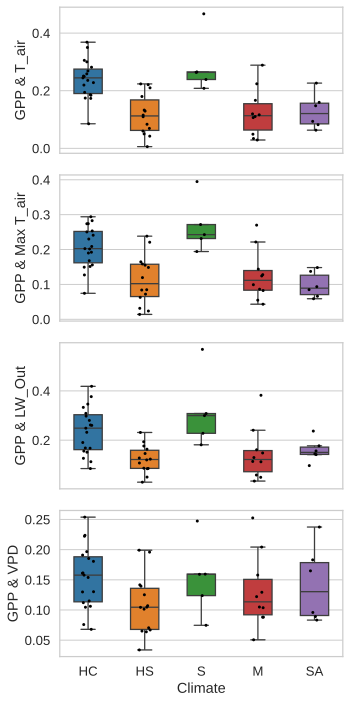

In [ ]:
# Box plots

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

palette_8 = [
    '#1f77b4',  # Blue
    '#ff7f0e',  # Orange
    '#2ca02c',  # Green
    '#d62728',  # Red
    '#9467bd',  # Purple
    '#8c564b',  # Brown
    '#e377c2',  # Pink
    '#bcbd22',  # Olive
]

f, axes = plt.subplots(4,1, figsize=(5,10))

desired_order = ['HC', 'HS', 'S', 'M', 'SA']

z1 = sns.boxplot(data = site_corrs, x = 'Climate', y = 'MI_GPP_Tair', order = desired_order, \
                 linewidth=1.3, ax=axes[0], palette=palette_8, showfliers = False, width=0.5)

z2 = sns.boxplot(data = site_corrs, x = 'Climate', y = 'MI_GPP_MaxTair', order = desired_order, \
                 linewidth=1.3, ax=axes[1], palette=palette_8, showfliers = False, width=0.5)

z3 = sns.boxplot(data = site_corrs, x = 'Climate', y = 'MI_GPP_LWOut', order = desired_order, \
                 linewidth=1.3, ax=axes[2], palette=palette_8, showfliers = False, width=0.5)

z4 = sns.boxplot(data = site_corrs, x = 'Climate', y = 'MI_GPP_VPD', order = desired_order, \
                 linewidth=1.3, ax=axes[3], palette=palette_8, showfliers = False, width=0.5)


# Add individual data points with dark colors
sns.stripplot(data=site_corrs, x='Climate', y='MI_GPP_Tair', order=desired_order, \
              color='black', size=3, jitter=True, ax=axes[0])

sns.stripplot(data=site_corrs, x='Climate', y='MI_GPP_MaxTair', order=desired_order, \
              color='black', size=3, jitter=True, ax=axes[1])

sns.stripplot(data=site_corrs, x='Climate', y='MI_GPP_LWOut', order=desired_order, \
              color='black', size=3, jitter=True, ax=axes[2])

sns.stripplot(data=site_corrs, x='Climate', y='MI_GPP_VPD', order=desired_order, \
              color='black', size=3, jitter=True, ax=axes[3])



z1.axes.get_xaxis().set_visible(False)
z2.axes.get_xaxis().set_visible(False)
z3.axes.get_xaxis().set_visible(False)

z1.axes.set_ylabel('GPP & T_air')
z2.axes.set_ylabel('GPP & Max T_air')
z3.axes.set_ylabel('GPP & LW_Out')
z4.axes.set_ylabel('GPP & VPD')

sns.set(font_scale=1.2,style='whitegrid')
plt.tight_layout()


# plt.savefig('MI_Climate.jpg', dpi=400)

In [ ]:
# os.chdir('/content/gdrive/MyDrive/Postdoc Research/RS Flux Feature Analysis/Flux Data')

# Ameriflux191 = pd.read_csv('Ameriflux_fluxnet_list_191.csv', index_col=None, header=0)

In [ ]:
# # Merge the two DataFrames based on 'SiteID'
# merged_df = pd.merge(site_corrs, Ameriflux191[['SiteID', 'Aridity_Index']], on='SiteID', how='left')

# # Add the 'Aridity_Index' column to 'site_corrs'
# site_corrs['Aridity_Index'] = merged_df['Aridity_Index']

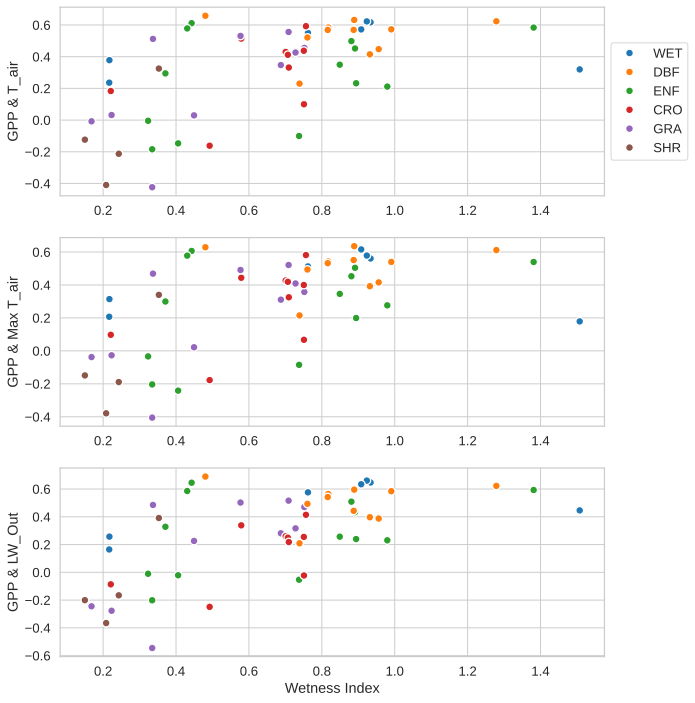

In [ ]:
# Scatter plots

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

palette_8 = [
    '#1f77b4',  # Blue
    '#ff7f0e',  # Orange
    '#2ca02c',  # Green
    '#d62728',  # Red
    '#9467bd',  # Purple
    '#8c564b',  # Brown
    '#e377c2',  # Pink
    '#bcbd22',  # Olive
]

f, axes = plt.subplots(3,1, figsize=(10,10))


z1 = sns.scatterplot(data = site_corrs, x = 'Wetness_Index', y = 'PC_GPP_Tair', s=60,\
                 linewidth=1.3, ax=axes[0], palette = palette_8, hue = 'PFT', legend=True)

z2 = sns.scatterplot(data = site_corrs, x = 'Wetness_Index', y = 'PC_GPP_MaxTair', s=60,\
                 linewidth=1.3, ax=axes[1], palette = palette_8, hue = 'PFT', legend=False)

z3 = sns.scatterplot(data = site_corrs, x = 'Wetness_Index', y = 'PC_GPP_LWOut', s=60,\
                 linewidth=1.3, ax=axes[2], palette = palette_8, hue = 'PFT', legend=False)



legend = z1.legend(loc='center left', bbox_to_anchor=(1, 0.5))


# z1.axes.get_xaxis().set_visible(False)
# z2.axes.get_xaxis().set_visible(False)
# z3.axes.get_xaxis().set_visible(False)
# z4.axes.get_xaxis().set_visible(False)

z1.axes.set_ylabel('GPP & T_air')
z2.axes.set_ylabel('GPP & Max T_air')
z3.axes.set_ylabel('GPP & LW_Out')

z3.axes.set_xlabel('Wetness Index')

z1.axes.set_xlabel('')
z2.axes.set_xlabel('')

sns.set(font_scale=1.2,style='whitegrid')
plt.tight_layout()


# plt.savefig('Spearman_MAT.jpg', dpi=400)

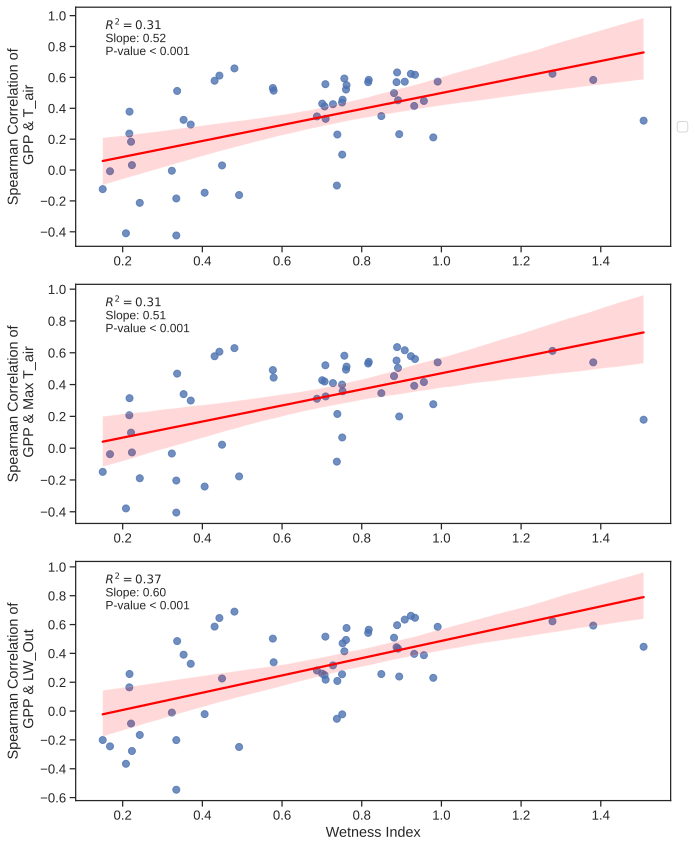

In [ ]:
from scipy.stats import linregress

# Assuming you have 'site_corrs' DataFrame defined with your data

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

f, axes = plt.subplots(3, 1, figsize=(10, 12))

# Define a function to calculate and annotate R^2, slope, and p-value on the plot
def annotate_regression_info(x, y, ax, order=1):
    p = np.polyfit(x, y, order)
    y_pred = np.polyval(p, x)

    # Get linear regression statistics
    slope, intercept, r_value, p_value, std_err = linregress(x, y)

    # Calculate R^2 value
    r_squared = r_value**2

    # Format p-value
    if p_value < 0.001:
        p_value_str = 'P-value < 0.001'
    else:
        p_value_str = f'P-value: {p_value:.4f}'

    # Annotate the plot
    textstr = f'$R^2 = {r_squared:.2f}$\nSlope: {slope:.2f}\n{p_value_str}'
    ax.annotate(textstr, xy=(0.05, 0.8), xycoords='axes fraction', fontsize=12)

# Create scatter plots with polynomial regression
z1 = sns.regplot(data=site_corrs, x='Wetness_Index', y='PC_GPP_Tair', order=1,
                  scatter_kws={'s': 50}, line_kws={'color': 'red'}, ax=axes[0])

z2 = sns.regplot(data=site_corrs, x='Wetness_Index', y='PC_GPP_MaxTair', order=1,
                  scatter_kws={'s': 50}, line_kws={'color': 'red'}, ax=axes[1])

z3 = sns.regplot(data=site_corrs, x='Wetness_Index', y='PC_GPP_LWOut', order=1,
                  scatter_kws={'s': 50}, line_kws={'color': 'red'}, ax=axes[2])

# Annotate regression information on each plot
annotate_regression_info(site_corrs['Wetness_Index'], site_corrs['PC_GPP_Tair'], axes[0])
annotate_regression_info(site_corrs['Wetness_Index'], site_corrs['PC_GPP_MaxTair'], axes[1])
annotate_regression_info(site_corrs['Wetness_Index'], site_corrs['PC_GPP_LWOut'], axes[2])

legend = z1.legend(loc='center left', bbox_to_anchor=(1, 0.5))

z1.axes.set_ylabel('Spearman Correlation of\n GPP & T_air')
z2.axes.set_ylabel('Spearman Correlation of\n GPP & Max T_air')
z3.axes.set_ylabel('Spearman Correlation of\n GPP & LW_Out')

z3.axes.set_xlabel('Wetness Index')

z1.axes.set_xlabel('')
z2.axes.set_xlabel('')

# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    # ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    # ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

sns.set(font_scale=1.2, style='white')
plt.tight_layout()

# plt.savefig('Pearson_Wetness.jpg', dpi=400)

## Phase 3: Tipping Points

### Scatterplots


In [ ]:
# Define a function to calculate and annotate R^2, optimal point (if a < 0), and p-value on the plot for second-order polynomial
def annotate_regression_info(x, y, ax):
    # Fit a second-order polynomial
    p = np.polyfit(x, y, 2)
    y_pred = np.polyval(p, x)

    # Extract coefficients (a, b, c) of the quadratic equation
    a, b, c = p

    # Calculate R^2 value
    r_squared = 1 - np.sum((y - y_pred)**2) / np.sum((y - np.mean(y))**2)

    # Format p-value
    p_value = linregress(x, y).pvalue
    if p_value < 0.001:
        p_value_str = 'P-value < 0.001'
    else:
        p_value_str = f'P-value: {p_value:.4f}'

    # Check if the parabola opens downward (a < 0)
    if a < 0:
        # Calculate x-coordinate of the minimum of the quadratic function
        optimal_x = -b / (2 * a)

        # Calculate optimal y-coordinate using the quadratic function
        optimal_y = a * optimal_x**2 + b * optimal_x + c

        # Annotate the plot with optimal point
        textstr = f'$R^2 = {r_squared:.2f}$\nOptimal Point: ({optimal_x:.2f}, {optimal_y:.2f})\n{p_value_str}'
        ax.annotate(textstr, xy=(0.02, 0.78), xycoords='axes fraction', fontsize=12)

        # Plot the optimal point on the graph
        ax.plot(optimal_x, optimal_y, marker='o', markersize=10, color='yellow')
    else:
        # Annotate the plot when a > 0
        textstr = f'$R^2 = {r_squared:.2f}$\na > 0\n{p_value_str}'
        ax.annotate(textstr, xy=(0.02, 0.78), xycoords='axes fraction', fontsize=12)


In [ ]:
# PFT

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(2,3, figsize=(18,8))


hue='T_air'
palette='inferno'
x = 'LW_Out'

################################################################################
data = Allsites[Allsites.PFT=='ENF']

z1 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[0,0], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.PFT=='DBF']

z2 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[0,1], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.PFT=='SHR']

z3 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[0,2], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.PFT=='GRA']

z4 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[1,0], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.PFT=='CRO']

z5 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[1,1], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.PFT=='WET']

z6 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[1,2], color=blue_color, edgecolor=edge_color)
################################################################################


# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    # ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    # ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel=None, ylabel='GPP (gC m-2 d-1)', title='Evergreen Needleleaf Forests')
z2.set(xlabel=None, ylabel=None, title='Deciduous Broadleaf Forests')
z3.set(xlabel=None, ylabel=None, title='Shrublands')
z4.set(xlabel='LW_Out (W m-2)', ylabel='GPP (gC m-2 d-1)', title='Grasslands')
z5.set(xlabel='LW_Out (W m-2)', ylabel=None, title='Croplands')
z6.set(xlabel='LW_Out (W m-2)', ylabel=None, title='Wetlands')

# empty_ax1 = plt.subplot(3, 3, 8)
# empty_ax1.axis('off')  # Turn off axis for the empty subplot
# empty_ax2 = plt.subplot(3, 3, 9)
# empty_ax2.axis('off')  # Turn off axis for the empty subplot


# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.25,style='white')
plt.tight_layout()


plt.savefig('TP_LWOut_PFT.jpg', dpi=400)

plt.close()

In [ ]:
# PFT (Parabola)

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(2,3, figsize=(18,8))


x = 'Max_T_air'


################################################################################
data = Allsites[Allsites.PFT=='ENF']

z1 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[0,0])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[0,0])
legend = z1.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[Allsites.PFT=='DBF']

z2 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[0,1])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[0,1])
legend = z2.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[Allsites.PFT=='SHR']

z3 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[0,2])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[0,2])
legend = z3.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[Allsites.PFT=='GRA']

z4 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[1,0])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[1,0])
legend = z4.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[Allsites.PFT=='CRO']

z5 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[1,1])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[1,1])
legend = z5.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[Allsites.PFT=='WET']

z6 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[1,2])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[1,2])
legend = z6.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################


# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    # ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    # ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel=None, ylabel='GPP (gC m-2 d-1)', title='Evergreen Needleleaf Forests')
z2.set(xlabel=None, ylabel=None, title='Deciduous Broadleaf Forests')
z3.set(xlabel=None, ylabel=None, title='Shrublands')
z4.set(xlabel='Max T_air (deg. C)', ylabel='GPP (gC m-2 d-1)', title='Grasslands')
z5.set(xlabel='Max T_air (deg. C)', ylabel=None, title='Croplands')
z6.set(xlabel='Max T_air (deg. C)', ylabel=None, title='Wetlands')

# empty_ax1 = plt.subplot(3, 3, 8)
# empty_ax1.axis('off')  # Turn off axis for the empty subplot
# empty_ax2 = plt.subplot(3, 3, 9)
# empty_ax2.axis('off')  # Turn off axis for the empty subplot


# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.25,style='white')
plt.tight_layout()


# plt.savefig('TP_MaxTair_PFT_Parabola.jpg', dpi=400)

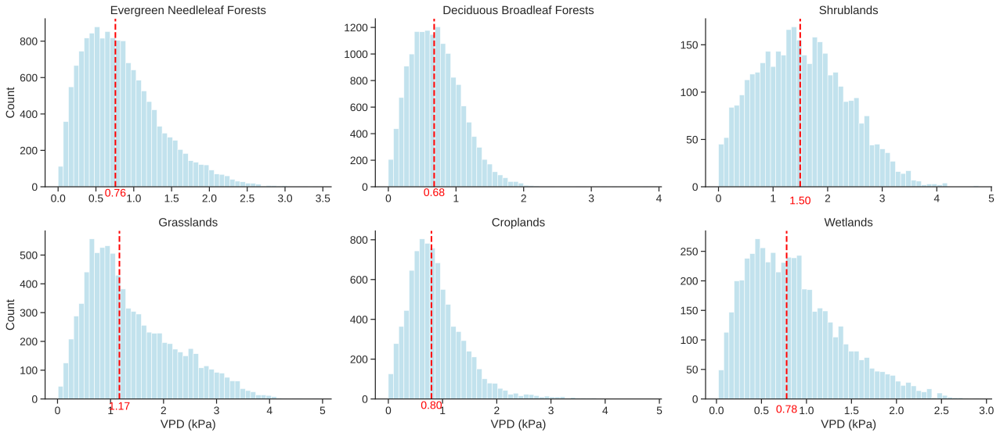

In [ ]:
# PFT (Histogram)

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(2,3, figsize=(18,8))


x = 'VPD_kPa'

################################################################################
data = Allsites[Allsites.PFT=='ENF']

z1 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[0,0])
# Add a dashed red line for the median
median_value = data[x].median()
z1.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z1.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[Allsites.PFT=='DBF']

z2 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[0,1])
# Add a dashed red line for the median
median_value = data[x].median()
z2.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z2.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[Allsites.PFT=='SHR']

z3 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[0,2])
# Add a dashed red line for the median
median_value = data[x].median()
z3.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z3.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[Allsites.PFT=='GRA']

z4 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[1,0])
# Add a dashed red line for the median
median_value = data[x].median()
z4.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z4.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[Allsites.PFT=='CRO']

z5 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[1,1])
# Add a dashed red line for the median
median_value = data[x].median()
z5.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z5.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[Allsites.PFT=='WET']

z6 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[1,2])
# Add a dashed red line for the median
median_value = data[x].median()
z6.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z6.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################


# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    # ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    # ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel=None, ylabel='Count', title='Evergreen Needleleaf Forests')
z2.set(xlabel=None, ylabel=None, title='Deciduous Broadleaf Forests')
z3.set(xlabel=None, ylabel=None, title='Shrublands')
z4.set(xlabel='VPD (kPa)', ylabel='Count', title='Grasslands')
z5.set(xlabel='VPD (kPa)', ylabel=None, title='Croplands')
z6.set(xlabel='VPD (kPa)', ylabel=None, title='Wetlands')

# empty_ax1 = plt.subplot(3, 3, 8)
# empty_ax1.axis('off')  # Turn off axis for the empty subplot
# empty_ax2 = plt.subplot(3, 3, 9)
# empty_ax2.axis('off')  # Turn off axis for the empty subplot


# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.25,style='white')
plt.tight_layout()


# plt.savefig('VPD_Histogram_PFT.jpg', dpi=400)

In [ ]:
# Climate

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(2,3, figsize=(18,8))

hue='T_air'
palette='inferno'
x = 'Max_T_air'

################################################################################
data = Allsites[Allsites.Climate=='HC']

z1 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[0,0], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.Climate=='HS']

z1 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[0,1], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.Climate=='S']

z1 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[0,2], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.Climate=='M']

z1 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[1,0], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.Climate=='SA']

z1 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[1,1], color=blue_color, edgecolor=edge_color)
################################################################################


# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    # ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    # ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel=None, ylabel='GPP (gC m-2 d-1)', title='Humid Continental')
z2.set(xlabel=None, ylabel=None, title='Humid Subtropical')
z3.set(xlabel='Max T_air (deg. C)', ylabel=None, title='Subarctic')
z4.set(xlabel='Max T_air (deg. C)', ylabel='GPP (gC m-2 d-1)', title='Mediterranean')
z5.set(xlabel='Max T_air (deg. C)', ylabel=None, title='Semi-arid')

empty_ax2 = plt.subplot(2, 3, 6)
empty_ax2.axis('off')  # Turn off axis for the empty subplot


# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.25,style='white')
plt.tight_layout()


plt.savefig('TP_MaxTair_Climate.jpg', dpi=400)

plt.close()

In [ ]:
# Climate (parabola)

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(2,3, figsize=(18,8))


x = 'Max_T_air'

################################################################################
data = Allsites[Allsites.Climate=='HC']

z1 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[0,0])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[0,0])
legend = z1.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[Allsites.Climate=='HS']

z2 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[0,1])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[0,1])
legend = z2.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[Allsites.Climate=='S']

z3 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[0,2])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[0,2])
legend = z3.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[Allsites.Climate=='M']

z4 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[1,0])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[1,0])
legend = z4.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[Allsites.Climate=='SA']

z5 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[1,1])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[1,1])
legend = z5.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################


# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    # ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    # ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel=None, ylabel='GPP (gC m-2 d-1)', title='Humid Continental')
z2.set(xlabel=None, ylabel=None, title='Humid Subtropical')
z3.set(xlabel='Max T_air (deg. C)', ylabel=None, title='Subarctic')
z4.set(xlabel='Max T_air (deg. C)', ylabel='GPP (gC m-2 d-1)', title='Mediterranean')
z5.set(xlabel='Max T_air (deg. C)', ylabel=None, title='Semi-arid')

empty_ax2 = plt.subplot(2, 3, 6)
empty_ax2.axis('off')  # Turn off axis for the empty subplot


# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.25,style='white')
plt.tight_layout()


# plt.savefig('TP_MaxTair_Climate_Parabola.jpg', dpi=400)

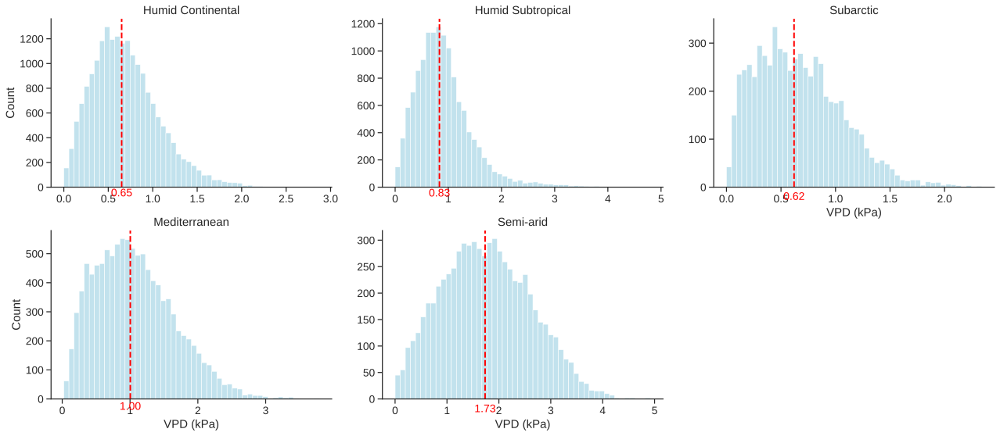

In [ ]:
# Climate (Histogram)

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(2,3, figsize=(18,8))

x = 'VPD_kPa'

################################################################################
data = Allsites[Allsites.Climate=='HC']

z1 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[0,0])
# Add a dashed red line for the median
median_value = data[x].median()
z1.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z1.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[Allsites.Climate=='HS']

z2 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[0,1])
# Add a dashed red line for the median
median_value = data[x].median()
z2.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z2.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[Allsites.Climate=='S']

z3 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[0,2])
# Add a dashed red line for the median
median_value = data[x].median()
z3.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z3.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[Allsites.Climate=='M']

z4 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[1,0])
# Add a dashed red line for the median
median_value = data[x].median()
z4.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z4.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[Allsites.Climate=='SA']

z5 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[1,1])
# Add a dashed red line for the median
median_value = data[x].median()
z5.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z5.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################


# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    # ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    # ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel=None, ylabel='Count', title='Humid Continental')
z2.set(xlabel=None, ylabel=None, title='Humid Subtropical')
z3.set(xlabel='VPD (kPa)', ylabel=None, title='Subarctic')
z4.set(xlabel='VPD (kPa)', ylabel='Count', title='Mediterranean')
z5.set(xlabel='VPD (kPa)', ylabel=None, title='Semi-arid')

empty_ax2 = plt.subplot(2, 3, 6)
empty_ax2.axis('off')  # Turn off axis for the empty subplot


# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.25,style='white')
plt.tight_layout()


# plt.savefig('VPD_Histogram_Climate.jpg', dpi=400)

In [ ]:
# os.chdir('/content/gdrive/MyDrive/Postdoc Research/RS Flux Feature Analysis/Flux Data')

# Ameriflux191 = pd.read_csv('Ameriflux_fluxnet_list_191.csv', index_col=None, header=0)

In [ ]:
# # Merge the two DataFrames based on 'SiteID'
# merged_df = pd.merge(Allsites, Ameriflux191[['SiteID', 'Aridity_Index']], on='SiteID', how='left')

In [ ]:
# Wetness Index

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(2,3, figsize=(18,8))


hue='T_air'
palette='inferno'
x = 'LW_Out'
################################################################################
data = Allsites[Allsites.Wetness_Index <= 0.2]

z1 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[0,0], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[(0.2 < Allsites.Wetness_Index) & (Allsites.Wetness_Index <= 0.4)]

z2 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[0,1], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[(0.4 < Allsites.Wetness_Index) & (Allsites.Wetness_Index <= 0.6)]

z3 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[0,2], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[(0.6 < Allsites.Wetness_Index) & (Allsites.Wetness_Index <= 0.8)]

z4 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[1,0], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[(0.8 < Allsites.Wetness_Index) & (Allsites.Wetness_Index <= 1)]

z5 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[1,1], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[1 < Allsites.Wetness_Index]

z6 = sns.scatterplot(data=data, x= x, y= 'GPP_day', ax=axes[1,2], color=blue_color, edgecolor=edge_color)
################################################################################


# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    # ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    # ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel=None, ylabel='GPP (gC m-2 d-1)', title='Wetness Index <= 0.2')
z2.set(xlabel=None, ylabel=None, title='0.2 < Wetness Index <= 0.4')
z3.set(xlabel=None, ylabel=None, title='0.4 < Wetness Index <= 0.6')
z4.set(xlabel='LW_Out (W m-2)', ylabel='GPP (gC m-2 d-1)', title='0.6 < Wetness Index <= 0.8')
z5.set(xlabel='LW_Out (W m-2)', ylabel=None, title='0.8 < Wetness Index <= 1')
z6.set(xlabel='LW_Out (W m-2)', ylabel=None, title='1 < Wetness Index')



# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.25,style='white')
plt.tight_layout()


plt.savefig('TP_LWOut_Wetness.jpg', dpi=400)

plt.close()

In [ ]:
# Wetness Index (Parabola)

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(2,3, figsize=(18,8))


x = 'Max_T_air'

################################################################################
data = Allsites[Allsites.Wetness_Index <= 0.2]

z1 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[0,0])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[0,0])
legend = z1.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[(0.2 < Allsites.Wetness_Index) & (Allsites.Wetness_Index <= 0.4)]

z2 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[0,1])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[0,1])
legend = z2.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[(0.4 < Allsites.Wetness_Index) & (Allsites.Wetness_Index <= 0.6)]

z3 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[0,2])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[0,2])
legend = z3.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[(0.6 < Allsites.Wetness_Index) & (Allsites.Wetness_Index <= 0.8)]

z4 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[1,0])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[1,0])
legend = z4.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[(0.8 < Allsites.Wetness_Index) & (Allsites.Wetness_Index <= 1)]

z5 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[1,1])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[1,1])
legend = z5.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################
data = Allsites[1 < Allsites.Wetness_Index]

z6 = sns.regplot(data=data, x= x, y= 'GPP_day', scatter_kws={'s': 20}, line_kws={'color': 'red'}, order=2, ax=axes[1,2])
annotate_regression_info(data[x], data['GPP_day'], ax=axes[1,2])
legend = z6.legend(loc='center left', bbox_to_anchor=(1, 0.5))
################################################################################


# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    # ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    # ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel=None, ylabel='GPP (gC m-2 d-1)', title='Wetness Index <= 0.2')
z2.set(xlabel=None, ylabel=None, title='0.2 < Wetness Index <= 0.4')
z3.set(xlabel=None, ylabel=None, title='0.4 < Wetness Index <= 0.6')
z4.set(xlabel='Max T_air (deg. C)', ylabel='GPP (gC m-2 d-1)', title='0.6 < Wetness Index <= 0.8')
z5.set(xlabel='Max T_air (deg. C)', ylabel=None, title='0.8 < Wetness Index <= 1')
z6.set(xlabel='Max T_air (deg. C)', ylabel=None, title='1 < Wetness Index')



# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.25,style='white')
plt.tight_layout()


# plt.savefig('TP_MaxTair_Wetness_Parabola.jpg', dpi=400)

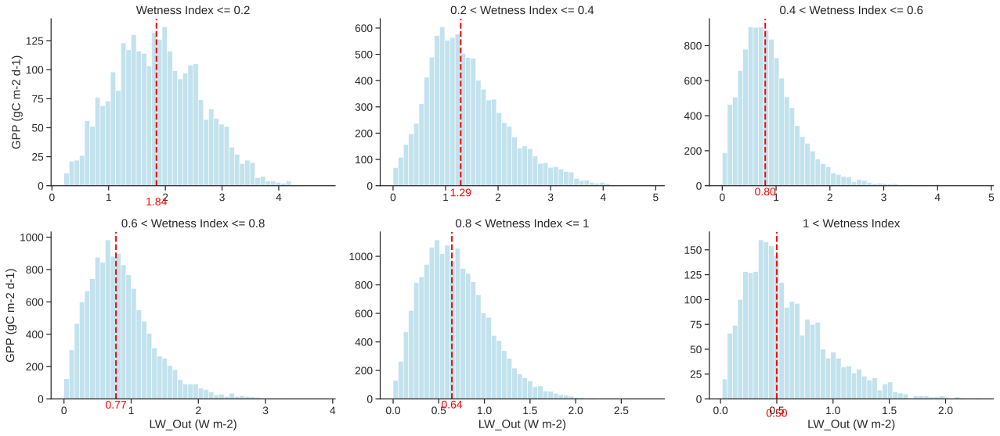

In [ ]:
# Wetness Index (Histogram)

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(2,3, figsize=(18,8))


x = 'VPD_kPa'

################################################################################
data = Allsites[Allsites.Wetness_Index <= 0.2]

z1 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[0,0])
# Add a dashed red line for the median
median_value = data[x].median()
z1.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z1.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[(0.2 < Allsites.Wetness_Index) & (Allsites.Wetness_Index <= 0.4)]

z2 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[0,1])
# Add a dashed red line for the median
median_value = data[x].median()
z2.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z2.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[(0.4 < Allsites.Wetness_Index) & (Allsites.Wetness_Index <= 0.6)]

z3 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[0,2])
# Add a dashed red line for the median
median_value = data[x].median()
z3.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z3.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[(0.6 < Allsites.Wetness_Index) & (Allsites.Wetness_Index <= 0.8)]

z4 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[1,0])
# Add a dashed red line for the median
median_value = data[x].median()
z4.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z4.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[(0.8 < Allsites.Wetness_Index) & (Allsites.Wetness_Index <= 1)]

z5 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[1,1])
# Add a dashed red line for the median
median_value = data[x].median()
z5.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z5.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################
data = Allsites[1 < Allsites.Wetness_Index]

z6 = sns.histplot(data=data, x=x, bins=50, color='lightblue', ax=axes[1,2])
# Add a dashed red line for the median
median_value = data[x].median()
z6.axvline(median_value, color='red', linestyle='dashed', linewidth=2)
# Add text for the median value below the x-axis line
z6.text(median_value, -10, f'{median_value:.2f}', color='red', ha='center', va='top')
################################################################################


# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    # ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    # ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel=None, ylabel='GPP (gC m-2 d-1)', title='Wetness Index <= 0.2')
z2.set(xlabel=None, ylabel=None, title='0.2 < Wetness Index <= 0.4')
z3.set(xlabel=None, ylabel=None, title='0.4 < Wetness Index <= 0.6')
z4.set(xlabel='LW_Out (W m-2)', ylabel='GPP (gC m-2 d-1)', title='0.6 < Wetness Index <= 0.8')
z5.set(xlabel='LW_Out (W m-2)', ylabel=None, title='0.8 < Wetness Index <= 1')
z6.set(xlabel='LW_Out (W m-2)', ylabel=None, title='1 < Wetness Index')



# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.25,style='white')
plt.tight_layout()


# plt.savefig('VPD_Histogram_Wetness.jpg', dpi=400)

## Phase 4: Individual Sites

In [ ]:
# Importing site_corrs

os.chdir('/content/gdrive/MyDrive/Postdoc Research/Tipping Points')

site_corrs = pd.read_csv('site_corrs_data.csv', index_col=None, header=0)

### Polynomial Fit

In [ ]:
# Linear (first order)

from scipy.stats import linregress

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 12}
plt.rc('font', **font)

# Sort site_corrs based on Wetness_Index
site_corrs_sorted = site_corrs.sort_values(by='Wetness_Index')

f, axes = plt.subplots(8, 7, figsize=(28, 25))

# Define a function to calculate and annotate R^2, slope, and p-value on the plot
def annotate_regression_info(x, y, ax, order=1):
    p = np.polyfit(x, y, order)
    y_pred = np.polyval(p, x)

    # Get linear regression statistics
    slope, intercept, r_value, p_value, std_err = linregress(x, y)

    # Calculate R^2 value
    r_squared = r_value**2

    # Format p-value
    if p_value < 0.001:
        p_value_str = 'P-value < 0.001'
    else:
        p_value_str = f'P-value: {p_value:.4f}'

    # Annotate the plot
    textstr = f'$R^2 = {r_squared:.2f}$\nSlope: {slope:.2f}\n{p_value_str}'
    ax.annotate(textstr, xy=(0.02, 0.78), xycoords='axes fraction', fontsize=12)

for i, (site, wetness_index) in enumerate(zip(site_corrs_sorted.SiteID, site_corrs_sorted.Wetness_Index)):
    data = Allsites[Allsites.SiteID == site]
    ax = axes[i // 7, i % 7]

    z1 = sns.regplot(data=data, x='Max_T_air', y='GPP_day', order=1,
                     scatter_kws={'s': 20}, line_kws={'color': 'red'}, ax=ax)

    annotate_regression_info(data['Max_T_air'], data['GPP_day'], ax)

    legend = z1.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    # Remove x-label for all subplots except the last row
    if i < 47:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('Max T_air (deg. C)')

    # Remove y-label for all subplots except the first column
    if i % 7 != 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('GPP (gC m-2 d-1)')


    # Add title based on the specified columns
    site_info = site_corrs.loc[site_corrs['SiteID'] == site]
    title_text = f"{site_info['SiteID'].values[0]}, {site_info['PFT'].values[0]}, {site_info['Climate'].values[0]}, WI={site_info['Wetness_Index'].values[0]}"

    ax.set_title(title_text, fontsize=12)


for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)


empty_ax1 = plt.subplot(8, 7, 55)
empty_ax1.axis('off')  # Turn off axis for the empty subplot
empty_ax2 = plt.subplot(8, 7, 56)
empty_ax2.axis('off')  # Turn off axis for the empty subplot

sns.set(font_scale=1,style='white')
plt.tight_layout()


# plt.savefig('GPP_MaxTair.jpg', dpi=400)

In [ ]:
# Quadratic (second order)

from scipy.stats import linregress

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 12}
plt.rc('font', **font)

# Sort site_corrs based on Wetness_Index
site_corrs_sorted = site_corrs.sort_values(by='Wetness_Index')

f, axes = plt.subplots(8, 7, figsize=(28, 25))

# Define a function to calculate and annotate R^2, optimal point (if a < 0), and p-value on the plot for second-order polynomial
def annotate_regression_info(x, y, ax):
    # Fit a second-order polynomial
    p = np.polyfit(x, y, 2)
    y_pred = np.polyval(p, x)

    # Extract coefficients (a, b, c) of the quadratic equation
    a, b, c = p

    # Calculate R^2 value
    r_squared = 1 - np.sum((y - y_pred)**2) / np.sum((y - np.mean(y))**2)

    # Format p-value
    p_value = linregress(x, y).pvalue
    if p_value < 0.001:
        p_value_str = 'P-value < 0.001'
    else:
        p_value_str = f'P-value: {p_value:.4f}'

    # Check if the parabola opens downward (a < 0)
    if a < 0:
        # Calculate x-coordinate of the minimum of the quadratic function
        optimal_x = -b / (2 * a)

        # Calculate optimal y-coordinate using the quadratic function
        optimal_y = a * optimal_x**2 + b * optimal_x + c

        # Annotate the plot with optimal point
        textstr = f'$R^2 = {r_squared:.2f}$\nOptimal Point: ({optimal_x:.2f}, {optimal_y:.2f})\n{p_value_str}'
        ax.annotate(textstr, xy=(0.02, 0.78), xycoords='axes fraction', fontsize=12)

        # Plot the optimal point on the graph
        ax.plot(optimal_x, optimal_y, marker='o', markersize=8, color='green')
    else:
        # Annotate the plot when a > 0
        textstr = f'$R^2 = {r_squared:.2f}$\na > 0\n{p_value_str}'
        ax.annotate(textstr, xy=(0.02, 0.78), xycoords='axes fraction', fontsize=12)


for i, (site, wetness_index) in enumerate(zip(site_corrs_sorted.SiteID, site_corrs_sorted.Wetness_Index)):
    data = Allsites[Allsites.SiteID == site]
    ax = axes[i // 7, i % 7]

    z1 = sns.regplot(data=data, x='LW_Out', y='GPP_day', order=2,
                     scatter_kws={'s': 20}, line_kws={'color': 'red'}, ax=ax)

    annotate_regression_info(data['LW_Out'], data['GPP_day'], ax)

    legend = z1.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    # Remove x-label for all subplots except the last row
    if i < 47:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('LW_Out (W m-2)')

    # Remove y-label for all subplots except the first column
    if i % 7 != 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('GPP (gC m-2 d-1)')


    # Add title based on the specified columns
    site_info = site_corrs.loc[site_corrs['SiteID'] == site]
    title_text = f"{site_info['SiteID'].values[0]}, {site_info['PFT'].values[0]}, {site_info['Climate'].values[0]}, WI={site_info['Wetness_Index'].values[0]}"

    ax.set_title(title_text, fontsize=12)


for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)


empty_ax1 = plt.subplot(8, 7, 55)
empty_ax1.axis('off')  # Turn off axis for the empty subplot
empty_ax2 = plt.subplot(8, 7, 56)
empty_ax2.axis('off')  # Turn off axis for the empty subplot

sns.set(font_scale=1,style='white')
plt.tight_layout()


# plt.savefig('GPP_LWOut_Parabola.jpg', dpi=400)

### Three-dimensional (Hue)

In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 12}
plt.rc('font', **font)

# Sort site_corrs based on Wetness_Index
site_corrs_sorted = site_corrs.sort_values(by='Wetness_Index')

f, axes = plt.subplots(8, 7, figsize=(28, 25))


for i, (site, wetness_index) in enumerate(zip(site_corrs_sorted.SiteID, site_corrs_sorted.Wetness_Index)):
    data = Allsites[Allsites.SiteID == site]
    ax = axes[i // 7, i % 7]

    z1 = sns.scatterplot(data=data, x='LW_Out', y='GPP_day', hue='VPD_kPa', palette= 'inferno',  ax=ax)


    # legend = z1.legend(loc='center left', bbox_to_anchor=(1, 0.5))

    # Remove x-label for all subplots except the last row
    if i < 47:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('LW_Out (W m-2)')

    # Remove y-label for all subplots except the first column
    if i % 7 != 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('GPP (gC m-2 d-1)')


    # Add title based on the specified columns
    site_info = site_corrs.loc[site_corrs['SiteID'] == site]
    title_text = f"{site_info['SiteID'].values[0]}, {site_info['PFT'].values[0]}, {site_info['Climate'].values[0]}, WI={site_info['Wetness_Index'].values[0]}"

    ax.set_title(title_text, fontsize=12)


for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)


empty_ax1 = plt.subplot(8, 7, 55)
empty_ax1.axis('off')  # Turn off axis for the empty subplot
empty_ax2 = plt.subplot(8, 7, 56)
empty_ax2.axis('off')  # Turn off axis for the empty subplot

sns.set(font_scale=1,style='white')
plt.tight_layout()


# plt.savefig('GPP_LWOut_VPD.jpg', dpi=400)

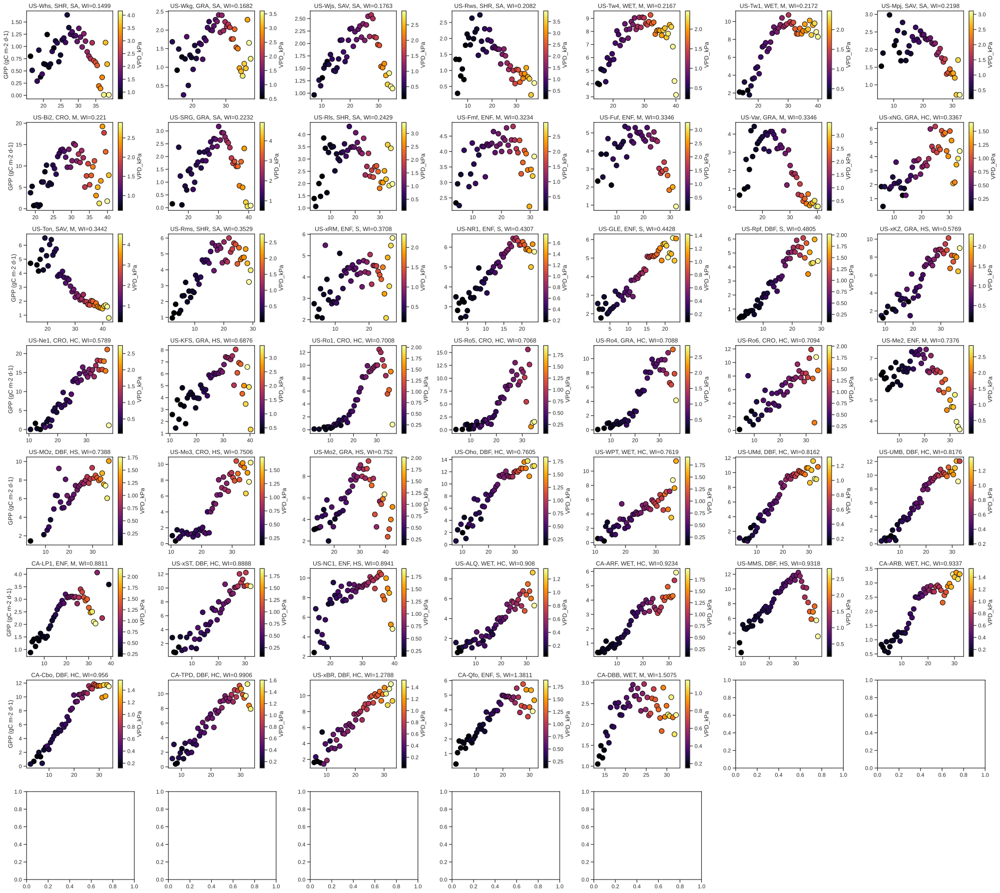

In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 12}
plt.rc('font', **font)

x = 'Max_T_air'

# Sort site_corrs based on Wetness_Index
site_corrs_sorted = site_corrs.sort_values(by='Wetness_Index')

f, axes = plt.subplots(8, 7, figsize=(28, 25), sharex=False, sharey=False)

for i, (site, wetness_index) in enumerate(zip(site_corrs_sorted.SiteID, site_corrs_sorted.Wetness_Index)):
    data = Allsites[Allsites.SiteID == site]
    ax = axes[i // 7, i % 7]

    # Calculate the bin edges for the X-axis
    bin_edges = np.linspace(data[x].min(), data[x].max(), 51)

    # Calculate average values for GPP_day and VPD within each bin
    bin_centers = 0.5 * (bin_edges[:-1] + bin_edges[1:])
    bin_avg_gpp = [data[(data[x] >= left) & (data[x] < right)]['GPP_day'].mean() for left, right in zip(bin_edges[:-1], bin_edges[1:])]
    bin_avg_vpd = [data[(data[x] >= left) & (data[x] < right)]['VPD_kPa'].mean() for left, right in zip(bin_edges[:-1], bin_edges[1:])]

    # Plot scatter plot with average values
    scatter = ax.scatter(bin_centers, bin_avg_gpp, c=bin_avg_vpd, cmap='inferno', marker='o', edgecolor='black', s=100)
    cbar = plt.colorbar(scatter, ax=ax)
    cbar.set_label('VPD_kPa')

    # Remove x-label for all subplots except the last row
    if i < 47:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('Max T_air (deg. C)')

    # Remove y-label for all subplots except the first column
    if i % 7 != 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('GPP (gC m-2 d-1)')

    # Add title based on the specified columns
    site_info = site_corrs.loc[site_corrs['SiteID'] == site]
    title_text = f"{site_info['SiteID'].values[0]}, {site_info['PFT'].values[0]}, {site_info['Climate'].values[0]}, WI={site_info['Wetness_Index'].values[0]}"

    ax.set_title(title_text, fontsize=12)

for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)

empty_ax1 = plt.subplot(8, 7, 55)
empty_ax1.axis('off')  # Turn off axis for the empty subplot
empty_ax2 = plt.subplot(8, 7, 56)
empty_ax2.axis('off')  # Turn off axis for the empty subplot

sns.set(font_scale=1, style='white')
plt.tight_layout()

# plt.savefig('GPP_MaxTair_VPD_binned.jpg', dpi=400)

In [ ]:
from scipy.optimize import curve_fit

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 12}
plt.rc('font', **font)

# Sort site_corrs based on Wetness_Index
site_corrs_sorted = site_corrs.sort_values(by='Wetness_Index')

f, axes = plt.subplots(8, 7, figsize=(28, 25))

# Calculate the median of the 'VPD_kPa' column
median_vpd = np.median(Allsites['VPD_kPa'])

# Define a linear function for fitting
def linear_func(x, m, b):
    return m * x + b

# Iterate through each subplot and fit lines based on 'VPD_kPa' values
for i, (site, wetness_index) in enumerate(zip(site_corrs_sorted.SiteID, site_corrs_sorted.Wetness_Index)):
    data = Allsites[Allsites.SiteID == site]
    ax = axes[i // 7, i % 7]

    x_data_low_vpd = data[data['VPD_kPa'] < median_vpd]['LW_Out']
    y_data_low_vpd = data[data['VPD_kPa'] < median_vpd]['GPP_day']

    x_data_high_vpd = data[data['VPD_kPa'] >= median_vpd]['LW_Out']
    y_data_high_vpd = data[data['VPD_kPa'] >= median_vpd]['GPP_day']

    # Fit the linear function to each subset of data
    params_low_vpd, _ = curve_fit(linear_func, x_data_low_vpd, y_data_low_vpd)
    params_high_vpd, _ = curve_fit(linear_func, x_data_high_vpd, y_data_high_vpd)

    # Generate a range of x values for plotting
    x_range = np.linspace(min(data['LW_Out']), max(data['LW_Out']), 100)

    # Calculate the corresponding y values using the fitted parameters
    y_fit_low_vpd = linear_func(x_range, *params_low_vpd)
    y_fit_high_vpd = linear_func(x_range, *params_high_vpd)

    # Plot the original data points and the fitted lines for low and high 'VPD_kPa'
    sns.scatterplot(data=data, x='LW_Out', y='GPP_day', hue='VPD_kPa', palette='inferno', ax=ax)
    ax.plot(x_range, y_fit_low_vpd, label='Fitted Low VPD', color='red')
    ax.plot(x_range, y_fit_high_vpd, label='Fitted High VPD', color='blue')

    # Remove x-label for all subplots except the last row
    if i < 47:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('LW_Out (W m-2)')

    # Remove y-label for all subplots except the first column
    if i % 7 != 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('GPP (gC m-2 d-1)')

    # Add title based on the specified columns
    site_info = site_corrs.loc[site_corrs['SiteID'] == site]
    title_text = f"{site_info['SiteID'].values[0]}, {site_info['PFT'].values[0]}, {site_info['Climate'].values[0]}, WI={site_info['Wetness_Index'].values[0]}"

    ax.set_title(title_text, fontsize=12)

    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)

# Add empty subplots
empty_ax1 = plt.subplot(8, 7, 55)
empty_ax1.axis('off')  # Turn off axis for the empty subplot
empty_ax2 = plt.subplot(8, 7, 56)
empty_ax2.axis('off')  # Turn off axis for the empty subplot

sns.set(font_scale=1, style='white')
plt.tight_layout()
# plt.savefig('GPP_LWOut_VPD.jpg', dpi=400)

In [ ]:
from scipy.optimize import curve_fit

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 12}
plt.rc('font', **font)

# Sort site_corrs based on Wetness_Index
site_corrs_sorted = site_corrs.sort_values(by='Wetness_Index')

f, axes = plt.subplots(8, 7, figsize=(28, 25))

# Calculate the median of the 'VPD_kPa' column
median_vpd = np.median(Allsites['VPD_kPa'])

# Define a linear function for fitting
def linear_func(x, m, b):
    return m * x + b

# Iterate through each subplot and fit lines based on 'VPD_kPa' values
for i, (site, wetness_index) in enumerate(zip(site_corrs_sorted.SiteID, site_corrs_sorted.Wetness_Index)):
    data = Allsites[Allsites.SiteID == site]
    ax = axes[i // 7, i % 7]

    x_data_low_vpd = data[data['VPD_kPa'] < median_vpd]['LW_Out']
    y_data_low_vpd = data[data['VPD_kPa'] < median_vpd]['GPP_day']

    x_data_high_vpd = data[data['VPD_kPa'] >= median_vpd]['LW_Out']
    y_data_high_vpd = data[data['VPD_kPa'] >= median_vpd]['GPP_day']

    # Fit the linear function to each subset of data
    params_low_vpd, _ = curve_fit(linear_func, x_data_low_vpd, y_data_low_vpd)
    params_high_vpd, _ = curve_fit(linear_func, x_data_high_vpd, y_data_high_vpd)

    # Generate a range of x values for plotting
    x_range = np.linspace(min(data['LW_Out']), max(data['LW_Out']), 100)

    # Calculate the corresponding y values using the fitted parameters
    y_fit_low_vpd = linear_func(x_range, *params_low_vpd)
    y_fit_high_vpd = linear_func(x_range, *params_high_vpd)

    # Plot the original data points and the fitted lines for low and high 'VPD_kPa'
    sns.scatterplot(data=data, x='LW_Out', y='GPP_day', hue='VPD_kPa', palette='inferno', ax=ax)
    ax.plot(x_range, y_fit_low_vpd, label=f'(S={params_low_vpd[0]:.2f})', color='red')
    ax.plot(x_range, y_fit_high_vpd, label=f'(S={params_high_vpd[0]:.2f})', color='blue')

    # Remove x-label for all subplots except the last row
    if i < 47:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('LW_Out (W m-2)')

    # Remove y-label for all subplots except the first column
    if i % 7 != 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('GPP (gC m-2 d-1)')

    # Add title based on the specified columns
    site_info = site_corrs.loc[site_corrs['SiteID'] == site]
    title_text = f"{site_info['SiteID'].values[0]}, {site_info['PFT'].values[0]}, {site_info['Climate'].values[0]}, WI={site_info['Wetness_Index'].values[0]}"

    ax.set_title(title_text, fontsize=12)

    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)

    # Add legend with slope information
    ax.legend()

# Add empty subplots
empty_ax1 = plt.subplot(8, 7, 55)
empty_ax1.axis('off')  # Turn off axis for the empty subplot
empty_ax2 = plt.subplot(8, 7, 56)
empty_ax2.axis('off')  # Turn off axis for the empty subplot

sns.set(font_scale=1, style='white')
plt.tight_layout()

plt.savefig('GPP_LWOut_VPD_median.jpg', dpi=400)

In [ ]:
# Fixed value of VPD

from scipy.optimize import curve_fit

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 12}
plt.rc('font', **font)

# Sort site_corrs based on Wetness_Index
site_corrs_sorted = site_corrs.sort_values(by='Wetness_Index')

f, axes = plt.subplots(8, 7, figsize=(28, 25))

# Use a fixed value for 'VPD_kPa'
fixed_vpd_value = 1

# Define a linear function for fitting
def linear_func(x, m, b):
    return m * x + b

# Iterate through each subplot and fit lines based on the fixed 'VPD_kPa' value
for i, (site, wetness_index) in enumerate(zip(site_corrs_sorted.SiteID, site_corrs_sorted.Wetness_Index)):
    data = Allsites[Allsites.SiteID == site]
    ax = axes[i // 7, i % 7]

    x_data_low_vpd = data[data['VPD_kPa'] < fixed_vpd_value]['LW_Out']
    y_data_low_vpd = data[data['VPD_kPa'] < fixed_vpd_value]['GPP_day']

    x_data_high_vpd = data[data['VPD_kPa'] >= fixed_vpd_value]['LW_Out']
    y_data_high_vpd = data[data['VPD_kPa'] >= fixed_vpd_value]['GPP_day']

    # Fit the linear function to each subset of data
    params_low_vpd, _ = curve_fit(linear_func, x_data_low_vpd, y_data_low_vpd)
    params_high_vpd, _ = curve_fit(linear_func, x_data_high_vpd, y_data_high_vpd)

    # Generate a range of x values for plotting
    x_range = np.linspace(min(data['LW_Out']), max(data['LW_Out']), 100)

    # Calculate the corresponding y values using the fitted parameters
    y_fit_low_vpd = linear_func(x_range, *params_low_vpd)
    y_fit_high_vpd = linear_func(x_range, *params_high_vpd)

    # Plot the original data points and the fitted lines for low and high 'VPD_kPa'
    sns.scatterplot(data=data, x='LW_Out', y='GPP_day', hue='VPD_kPa', palette='inferno', ax=ax)
    ax.plot(x_range, y_fit_low_vpd, label='Fitted Low VPD', color='red')
    ax.plot(x_range, y_fit_high_vpd, label='Fitted High VPD', color='blue')

    # Remove x-label for all subplots except the last row
    if i < 47:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('LW_Out (W m-2)')

    # Remove y-label for all subplots except the first column
    if i % 7 != 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('GPP (gC m-2 d-1)')

    # Add title based on the specified columns
    site_info = site_corrs.loc[site_corrs['SiteID'] == site]
    title_text = f"{site_info['SiteID'].values[0]}, {site_info['PFT'].values[0]}, {site_info['Climate'].values[0]}, WI={site_info['Wetness_Index'].values[0]}"

    ax.set_title(title_text, fontsize=12)

    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)

# Add empty subplots
empty_ax1 = plt.subplot(8, 7, 55)
empty_ax1.axis('off')  # Turn off axis for the empty subplot
empty_ax2 = plt.subplot(8, 7, 56)
empty_ax2.axis('off')  # Turn off axis for the empty subplot

sns.set(font_scale=1, style='white')
plt.tight_layout()
# plt.savefig('GPP_LWOut_VPD.jpg', dpi=400)

### Histograms

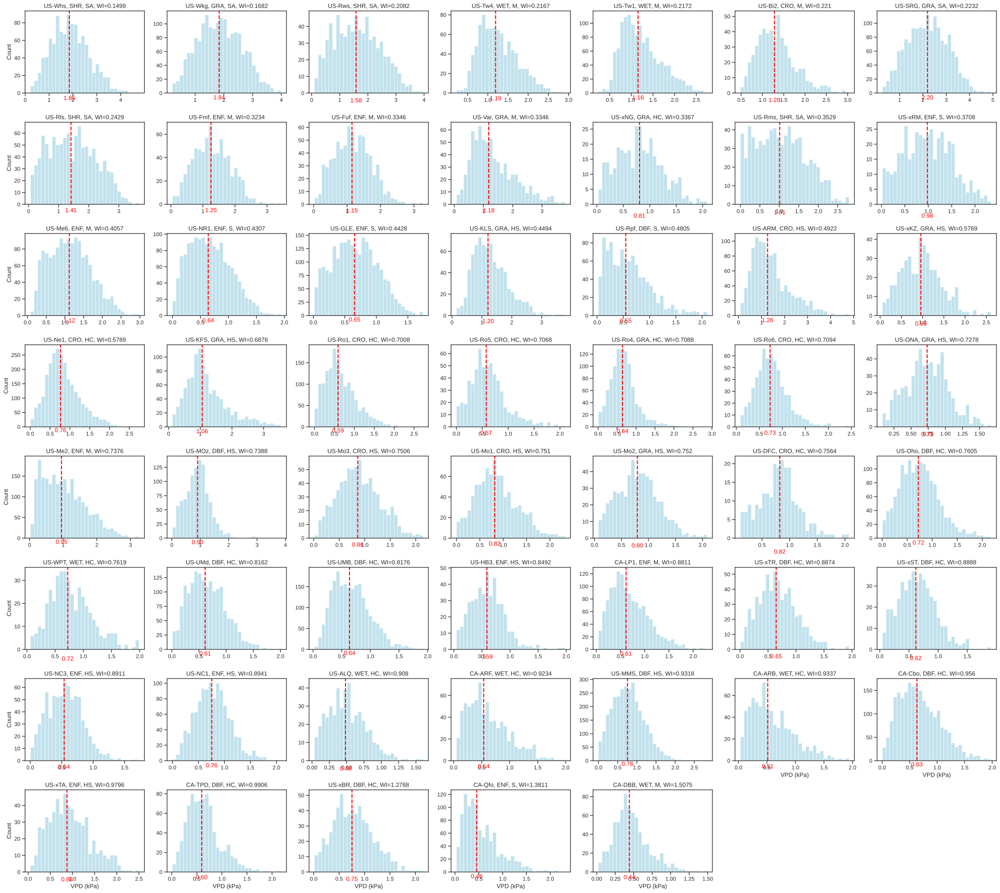

In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 12}
plt.rc('font', **font)

# Sort site_corrs based on Wetness_Index
site_corrs_sorted = site_corrs.sort_values(by='Wetness_Index')

f, axes = plt.subplots(8, 7, figsize=(28, 25))

for i, (site, wetness_index) in enumerate(zip(site_corrs_sorted.SiteID, site_corrs_sorted.Wetness_Index)):
    data = Allsites[Allsites.SiteID == site]
    ax = axes[i // 7, i % 7]

    # z1 = sns.scatterplot(data=data, x='LW_Out', y='GPP_day', hue='VPD_kPa', palette= 'inferno',  ax=ax)
    z1 = sns.histplot(data=data, x='VPD_kPa', ax=ax, bins=30, color='lightblue')

    # Add a dashed red line for the median
    median_value = data['VPD_kPa'].median()
    ax.axvline(median_value, color='red', linestyle='dashed', linewidth=2)

    # Add text for the median value below the x-axis line
    ax.text(median_value, -3, f'{median_value:.2f}', color='red', ha='center', va='top')

    # Remove x-label for all subplots except the last row
    if i < 47:
        ax.set_xlabel('')
    else:
        ax.set_xlabel('VPD (kPa)')

    # Remove y-label for all subplots except the first column
    if i % 7 != 0:
        ax.set_ylabel('')
    else:
        ax.set_ylabel('Count')

    # Add title based on the specified columns
    site_info = site_corrs.loc[site_corrs['SiteID'] == site]
    title_text = f"{site_info['SiteID'].values[0]}, {site_info['PFT'].values[0]}, {site_info['Climate'].values[0]}, WI={site_info['Wetness_Index'].values[0]}"

    ax.set_title(title_text, fontsize=12)

for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)

empty_ax1 = plt.subplot(8, 7, 55)
empty_ax1.axis('off')  # Turn off axis for the empty subplot
empty_ax2 = plt.subplot(8, 7, 56)
empty_ax2.axis('off')  # Turn off axis for the empty subplot

sns.set(font_scale=1, style='white')
plt.tight_layout()

# plt.savefig('VPD_Histogram.jpg', dpi=400)
plt.show()


In [ ]:
# from scipy.stats import linregress

# # Set the font to Liberation Sans
# font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
# plt.rc('font', **font)

# # Sort site_corrs based on Wetness_Index
# site_corrs_sorted = site_corrs.sort_values(by='Wetness_Index')

# f, axes = plt.subplots(8, 7, figsize=(25, 25))

# # Define a function to calculate and annotate R^2, slope, and p-value on the plot
# def annotate_regression_info(x, y, ax, order=1):
#     p = np.polyfit(x, y, order)
#     y_pred = np.polyval(p, x)

#     # Get linear regression statistics
#     slope, intercept, r_value, p_value, std_err = linregress(x, y)

#     # Calculate R^2 value
#     r_squared = r_value**2

#     # Format p-value
#     if p_value < 0.001:
#         p_value_str = 'P-value < 0.001'
#     else:
#         p_value_str = f'P-value: {p_value:.4f}'

#     # Annotate the plot
#     textstr = f'$R^2 = {r_squared:.2f}$\nSlope: {slope:.2f}\n{p_value_str}'
#     ax.annotate(textstr, xy=(0.05, 0.8), xycoords='axes fraction', fontsize=12)

# for i, (site, wetness_index) in enumerate(zip(site_corrs_sorted.SiteID, site_corrs_sorted.Wetness_Index)):
#     data = Allsites[Allsites.SiteID == site]
#     ax = axes[i // 7, i % 7]

#     # Use hexbin plot for density visualization
#     z1 = ax.hexbin(x=data['LW_Out'], y=data['GPP_day'], gridsize=20, cmap='viridis', mincnt=1)

#     annotate_regression_info(data['LW_Out'], data['GPP_day'], ax)

#     # Remove x-label for all subplots except the last row
#     if i < 47:
#         ax.set_xlabel('')
#     else:
#         ax.set_xlabel('LW_Out (W m-2)')

#     # Remove y-label for all subplots except the first column
#     if i % 7 != 0:
#         ax.set_ylabel('')
#     else:
#         ax.set_ylabel('GPP (gC m-2 d-1)')

# # Add a colorbar for density
# cb = plt.colorbar(z1, ax=axes, pad=0.02, aspect=40)
# cb.set_label('Density')

# empty_ax1 = plt.subplot(8, 7, 55)
# empty_ax1.axis('off')  # Turn off axis for the empty subplot
# empty_ax2 = plt.subplot(8, 7, 56)
# empty_ax2.axis('off')  # Turn off axis for the empty subplot

# plt.show()


In [ ]:
!pip install ruptures

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 6.2 MB/s eta 0:00:00


In [ ]:
import ruptures as rpt

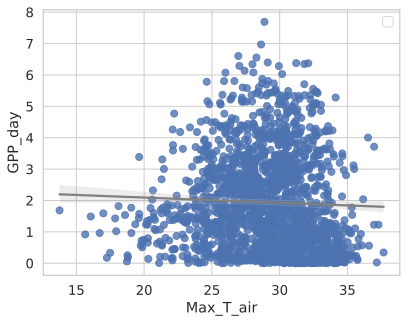

In [ ]:

data = Allsites[Allsites.SiteID == 'US-Wkg']

# Assuming 'data' is your DataFrame
x_values = data['Max_T_air'].values
y_values = data['GPP_day'].values

# Create a 1D signal for ruptures
signal = np.array(y_values, dtype=float).reshape(-1, 1)

# Perform changepoint detection
algo = rpt.Pelt(model="linear", min_size=10).fit(signal)
result = algo.predict(pen=10)

# Get the changepoint indices
changepoints = np.where(result == 1)[0]

# Plot the scatter plot
sns.regplot(data=data, x='Max_T_air', y='GPP_day', order=1, scatter_kws={'s': 50}, line_kws={'color': 'gray'})

# Highlight the changepoints
for cp in changepoints:
    plt.axvline(x=x_values[cp], color='red', linestyle='--', label='Changepoint')

# Customize the plot
plt.legend()
plt.show()

In [ ]:
from scipy.stats import linregress

# Assuming 'data' is your DataFrame
x_values = data['Max_T_air'].values
y_values = data['GPP_day'].values

# Calculate the overall correlation
overall_corr, _ = linregress(x_values, y_values)[:2]

# Define a function to calculate the correlation for a given tipping point
def calculate_corr_tipping_point(tipping_point):
    segment1 = data[data['Max_T_air'] <= tipping_point]
    segment2 = data[data['Max_T_air'] > tipping_point]

    corr1, _ = linregress(segment1['Max_T_air'], segment1['GPP_day'])[:2]
    corr2, _ = linregress(segment2['Max_T_air'], segment2['GPP_day'])[:2]

    return corr1, corr2

# Test different tipping points
tipping_points = np.unique(x_values)

correlations = [abs(calculate_corr_tipping_point(tp)[0] - calculate_corr_tipping_point(tp)[1]) for tp in tipping_points]

# Find the tipping point with the maximum change in correlation
best_tipping_point = tipping_points[np.argmax(correlations)]

# Plot the scatter plot
sns.regplot(data=data, x='Max_T_air', y='GPP_day', order=1, scatter_kws={'s': 50}, line_kws={'color': 'gray'})

# Highlight the tipping point
plt.axvline(x=best_tipping_point, color='red', linestyle='--', label='Tipping Point')

# Customize the plot
plt.legend()
plt.show()

ValueError: Inputs must not be empty.

## Phase 5: XGBoost, PDP, ALE

In [ ]:
!pip install pdpbox==0.2.0

In [ ]:
# pip install git+https://github.com/MaximeJumelle/ALEPython.git@dev#egg=alepython

In [ ]:
!pip install PyALE

In [ ]:
# Installing Optuna

!pip install -U optuna

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, r2_score
import xgboost as xgb
from math import sqrt
from pdpbox import pdp, get_dataset, info_plots
from sklearn.inspection import PartialDependenceDisplay
# from alepython import ale_plot
import optuna
from PyALE import ale

### XGBoost and beyond

In [ ]:
# data = Allsites[Allsites.PFT == 'CRO']
# data = Allsites[(Allsites.Wetness_Index  > 0.6) & (Allsites.Wetness_Index  <= 0.8)]
data = Allsites

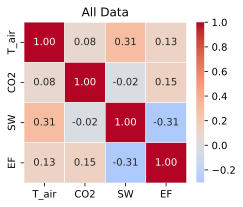

In [ ]:
# Correlation Matrix

data_x = data[['T_air', 'CO2', 'SW', 'EF']]

# Calculate the correlation matrix
correlation_matrix = data_x.corr('pearson')

# Create a heatmap using seaborn
plt.figure(figsize=(3.5, 3))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5, center=0)
plt.title('All Data')

plt.tight_layout()

# plt.savefig('correlation_matrix_AllData.jpg', dpi=400)

In [ ]:
# Training and testing the model

# Split the data into features (X) and target variable (y)
X = data[['T_air', 'CO2', 'SW', 'EF']]
y = data['GPP_day']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Instantiate the XGBoost regressor
model = xgb.XGBRegressor(objective ='reg:squarederror', random_state=42)

# Train the model on the training set
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model performance (e.g., using Mean Squared Error)
rmse = sqrt(mean_squared_error(y_test, y_pred))
print(f'Root Mean Squared Error: {rmse} gC/m2/day')

r2 = r2_score(y_test, y_pred)
print(f'R^2: {r2}')

Root Mean Squared Error: 2.9941268543335506 gC/m2/day
R^2: 0.5258218062909248


In [ ]:
# Hyperparameter Optimization with Optuna

# Split the data into features (X) and target variable (y)
X = data[['T_air', 'CO2', 'SW', 'EF']]
y = data['GPP_day']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the objective function for Optuna
def objective(trial):
    params = {
        'objective': 'reg:squarederror',
        'eval_metric': 'rmse',
        'booster': trial.suggest_categorical('booster', ['gbtree', 'gblinear', 'dart']),
        'lambda': trial.suggest_loguniform('lambda', 1e-8, 1.0),
        'alpha': trial.suggest_loguniform('alpha', 1e-8, 1.0),
        'max_depth': trial.suggest_int('max_depth', 3, 10),
        'eta': trial.suggest_loguniform('eta', 1e-8, 1.0),
        'gamma': trial.suggest_loguniform('gamma', 1e-8, 1.0),
        'subsample': trial.suggest_float('subsample', 0.1, 1.0),
        'colsample_bytree': trial.suggest_float('colsample_bytree', 0.1, 1.0),
        'min_child_weight': trial.suggest_float('min_child_weight', 1, 10),
        'n_estimators': trial.suggest_int('n_estimators', 50, 300),
        'tree_method': 'gpu_hist'  # Enable GPU
    }

    model = xgb.XGBRegressor(**params, random_state=42)
    model.fit(X_train, y_train)
    predictions = model.predict(X_test)
    rmse = np.sqrt(mean_squared_error(y_test, predictions))

    return rmse

# Create and run the Optuna study with a TPE sampler and Median Pruner
sampler = optuna.samplers.TPESampler(seed=42)
pruner = optuna.pruners.MedianPruner(n_startup_trials=5, n_warmup_steps=10, interval_steps=1)
study = optuna.create_study(direction='minimize', sampler=sampler, pruner=pruner)
study.optimize(objective, n_trials=100)

# Print the best hyperparameters and corresponding RMSE
print("Best Hyperparameters:", study.best_params)
print("Best RMSE:", study.best_value)

[I 2025-01-01 22:45:47,103] A new study created in memory with name: no-name-4f6ffda0-a0ff-4ead-b37b-a69d9756ea98
[I 2025-01-01 22:45:49,970] Trial 0 finished with value: 4.34809752375276 and parameters: {'booster': 'gblinear', 'lambda': 0.0006155564318973012, 'alpha': 1.77071686435378e-07, 'max_depth': 4, 'eta': 2.9152036385288193e-08, 'gamma': 0.08499808989182997, 'subsample': 0.6410035105688879, 'colsample_bytree': 0.737265320016441, 'min_child_weight': 1.185260448662222, 'n_estimators': 293}. Best is trial 0 with value: 4.34809752375276.
[I 2025-01-01 22:45:51,408] Trial 1 finished with value: 4.345770634086496 and parameters: {'booster': 'gbtree', 'lambda': 2.9324868872723725e-07, 'alpha': 2.716051144654844e-06, 'max_depth': 7, 'eta': 2.85469785779718e-05, 'gamma': 2.1371407316372935e-06, 'subsample': 0.6506676052501416, 'colsample_bytree': 0.22554447458683766, 'min_child_weight': 3.629301836816963, 'n_estimators': 141}. Best is trial 1 with value: 4.345770634086496.
[I 2025-01-01

Best Hyperparameters: {'booster': 'gbtree', 'lambda': 0.0002871842400259081, 'alpha': 2.5602214835339553e-08, 'max_depth': 7, 'eta': 0.10399307401961647, 'gamma': 3.495352815800317e-08, 'subsample': 0.887830785024396, 'colsample_bytree': 0.8290851488344083, 'min_child_weight': 2.661343227154414, 'n_estimators': 91}
Best RMSE: 2.971704682262478


In [ ]:
best_params = {'booster': 'gbtree', 'lambda': 0.0002871842400259081, 'alpha': 2.5602214835339553e-08, 'max_depth': 7, 'eta': 0.10399307401961647, 'gamma': 3.495352815800317e-08, 'subsample': 0.887830785024396, 'colsample_bytree': 0.8290851488344083, 'min_child_weight': 2.661343227154414, 'n_estimators': 91}

In [ ]:
# Training the model with the best hyperparameters

# Assuming study is your Optuna study object with the best hyperparameters
# best_params = study.best_params

# Split the data into features (X) and target variable (y)
X = data[['T_air', 'CO2', 'SW', 'EF']]
y = data['GPP_day']

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Instantiate the XGBoost regressor with the best hyperparameters
model = xgb.XGBRegressor(objective='reg:squarederror', random_state=42, **best_params, importance_type='gain')

# Train the model on the entire training set
model.fit(X_train, y_train)

# Get feature importances
feature_importance = model.feature_importances_

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model performance (e.g., using Mean Squared Error)
rmse = sqrt(mean_squared_error(y_test, y_pred))
print(f'Root Mean Squared Error: {rmse} gC/m2/day')

r2 = r2_score(y_test, y_pred)
print(f'R^2: {r2}')

# Print feature importance
print()
print("Feature Importance:")
for i, feature in enumerate(X.columns):
    print(f"{feature}: {feature_importance[i]}")

Root Mean Squared Error: 2.9742106193246127 gC/m2/day
R^2: 0.532109071776057

Feature Importance:
T_air: 0.17929428815841675
CO2: 0.07863342016935349
SW: 0.20151865482330322
EF: 0.5405536890029907


In [ ]:
# Create scatter plot with 1:1 line
fig, ax = plt.subplots(figsize=(5, 4))

plt.scatter(y_test, y_pred, alpha=0.7, s=2)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], '--', color='red', linewidth=2, label='1:1 line')

# Add labels and title
plt.xlabel('Actual GPP (gC/m2/day)')
plt.ylabel('Predicted GPP (gC/m2/day)')
plt.title('All Data')

# Add R-squared and RMSE annotations
plt.annotate(f'R-squared: {r2:.3f}', xy=(0.05, 0.85), xycoords='axes fraction', fontsize=10)
plt.annotate(f'RMSE: {rmse:.3f} gC/m2/day', xy=(0.05, 0.78), xycoords='axes fraction', fontsize=10)

# Add legend
plt.legend()

plt.tight_layout()


# plt.savefig('Scatterplot_AllData.jpg', dpi=400)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
 !pip install --upgrade xgboost scikit-learn

AttributeError: 'super' object has no attribute '__sklearn_tags__'

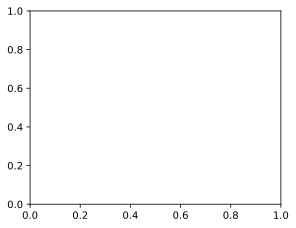

In [ ]:
# 1-D PDP plts

fig, ax = plt.subplots(figsize=(4.5, 3.5))
PartialDependenceDisplay.from_estimator(model, X_train, features=[0], ax=ax, grid_resolution=20)
plt.title('All Data')

plt.tight_layout()

# plt.savefig('PDP1D_AllData.jpg', dpi=400)

AttributeError: 'super' object has no attribute '__sklearn_tags__'

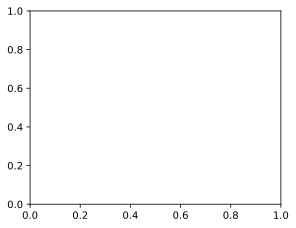

In [ ]:
# 2-D PDP plots

fig, ax = plt.subplots(figsize=(4.5, 3.5))
features = [(0, 3)]  # Choose the indices of the two features for the 2D plot
PartialDependenceDisplay.from_estimator(model, X_test, features=features, ax=ax, grid_resolution=10)
ax.set_title('1 < WI')

plt.tight_layout()

# plt.savefig('PDP2D_WI1.jpg', dpi=400)

In [ ]:
# f = ale_plot(model, X_train, 'T_air', bins=20)

In [ ]:
fig, ax = plt.subplots(figsize=(4.5, 3.5))
ale_eff = ale(X=X_train, model=model, feature=['T_air'], grid_size=20, include_CI=False, fig=fig, ax=ax)

ax.set_title('1 < WI')
ax.set_xlabel("T_air")
ax.set_ylabel("Effect on Prediction (centered)")

plt.tight_layout()

# plt.savefig('ALE_WI1.jpg', dpi=400)

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
# ale_eff = ale(X=X_train, model=model, feature=['EF', 'T_air'], grid_size=10)

### Feature Importance Visualizations

In [ ]:
os.chdir('/content/gdrive/MyDrive/Postdoc Research/Tipping Points')

FI_PFT = pd.read_csv('FeatureImportance_PFT.csv', index_col=None, header=0)
FI_Climate = pd.read_csv('FeatureImportance_Climate.csv', index_col=None, header=0)
FI_WI = pd.read_csv('FeatureImportance_WetnessIndex.csv', index_col=None, header=0)

In [ ]:
FI_WI


,WI,T_air,CO2,SW,EF
0,WI <= 0.2,0.137551,0.123623,0.178951,0.559875
1,0.2 < WI <= 0.4,0.120460,0.114455,0.210948,0.554137
2,0.4 < WI <= 0.6,0.150953,0.282850,0.251153,0.315044
3,0.6 < WI <= 0.8,0.131716,0.059073,0.400229,0.408982
4,0.8 < WI <= 1,0.320226,0.089041,0.296703,0.294030
5,1 < WI,0.348573,0.135254,0.266399,0.249774


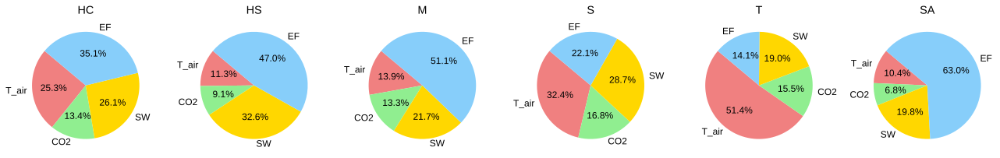

In [ ]:
df = FI_Climate

# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 12}
plt.rc('font', **font)

# Define colors for each column
colors = ['lightcoral', 'lightgreen', 'gold', 'lightskyblue']

# Create a figure and axis objects
fig, axs = plt.subplots(1, len(df), figsize=(18, 3))

# Iterate through each row of the DataFrame
for i, row in df.iterrows():
    # Extract PFT and numeric values for each row
    pft = row['Climate']
    values = row[['T_air', 'CO2', 'SW', 'EF']].tolist()

    # Create pie chart for each row
    axs[i].pie(values, labels=['T_air', 'CO2', 'SW', 'EF'], colors=colors, autopct='%1.1f%%', startangle=140)
    axs[i].set_title(pft)

# Adjust layout
plt.tight_layout()


# plt.savefig('Pie_Climate.jpg', dpi=400)

## Phase 6: Trend Analysis

In [ ]:
# Loading ERA5 Data

path = r'/content/gdrive/MyDrive/Postdoc Research/Tipping Points/ERA5 MM 1981-2021'
all_files = glob.glob(path + "/*.csv")

ERA5 = []

for filename in all_files:
    df = pd.read_csv(filename, index_col=None, header=0)

    # Extract SiteID from the filename (assuming the format is "AMF_XX-XXX_...")
    site_id = filename.split('_')[1]
    # site_id = '-'.join(site_id)

    # Add a new column "SiteID" with the extracted value
    df['SiteID'] = site_id

    ERA5.append(df)

In [ ]:
# TIMESTAMP to datetime

for i in range(len(ERA5)):
  ERA5[i]['TIMESTAMP'] = pd.to_datetime(ERA5[i]['TIMESTAMP'], format='%Y%m')

In [ ]:
# Picking May to September

for i in range(len(ERA5)):
  mask = (ERA5[i]['TIMESTAMP'].dt.month >= 5) & (ERA5[i]['TIMESTAMP'].dt.month <= 9)
  ERA5[i] = ERA5[i][mask]

In [ ]:
# Picking desired columns

for i in range(len(ERA5)):
  ERA5[i] = ERA5[i][['TIMESTAMP', 'SiteID', 'TA_ERA_DAY']]
  ERA5[i].columns = ['Date', 'SiteID', 'T_air_day']

In [ ]:
# Get the average for months 5 to 9 for each year

for i in range(len(ERA5)):
  ERA5[i]['Year'] = ERA5[i]['Date'].dt.year
  ERA5[i] = ERA5[i].groupby(['Year', 'SiteID'])['T_air_day'].mean().reset_index()

In [ ]:
ERA5[0]

,Year,SiteID,T_air_day
0,1981,CA-ARB,12.8066
1,1982,CA-ARB,12.1244
2,1983,CA-ARB,13.3888
3,1984,CA-ARB,12.6318
4,1985,CA-ARB,11.7430
5,1986,CA-ARB,11.9832
6,1987,CA-ARB,12.8910
7,1988,CA-ARB,13.3606
8,1989,CA-ARB,13.2856
9,1990,CA-ARB,12.5912


In [ ]:
# pymannkendall library

!pip install pymannkendall
import pymannkendall as mk

In [ ]:
MK_trend = pd.DataFrame(columns=['SiteID', 'P', 'Z'])

# Iterate over each DataFrame in ERA5
for df in ERA5:
    # Get the SiteID from the DataFrame
    site_id = df['SiteID'].iloc[0]

    # Perform Mann-Kendall test
    result = mk.original_test(df['T_air_day'])

    # Extract Z and p-values
    Z = result.z
    p = result.p

    # Append SiteID, Z, and p-values to MK_trend DataFrame
    MK_trend = MK_trend.append({'SiteID': site_id, 'Z': Z, 'P': p}, ignore_index=True)

In [ ]:
os.chdir('/content/gdrive/MyDrive/Postdoc Research/Tipping Points')

Ameriflux191 = pd.read_csv('Ameriflux_fluxnet_list_191.csv', index_col=None, header=0)

In [ ]:
# Merge the two DataFrames based on 'SiteID'

merging_columns = ['SiteID','IGBP', 'Koppen', 'Wetness_Index']
MK_trend = pd.merge(MK_trend, Ameriflux191[merging_columns], on='SiteID', how='left')

In [ ]:
MK_trend['PFT'] = MK_trend['IGBP'].replace({'WSA': 'SAV', 'SAV': 'SAV', 'CSH': 'SHR', 'OSH': 'SHR'})

In [ ]:
MK_trend['Climate'] = MK_trend['Koppen'].replace({'Dfb': 'HC', 'Dfa': 'HC', 'Dsb': 'HC', 'Dsa': 'HC',\
                                                  'Cfa': 'HS', 'Dfc': 'S', 'Dfd': 'S', 'Dwc': 'S',\
                                                  'Csa': 'M', 'Csb': 'M', 'Bsk': 'SA', 'Bsh': 'SA',\
                                                  'ET': 'T', 'Cfb': 'O', 'Bwk': 'A', 'Bwh': 'A'})

In [ ]:
MK_trend

,SiteID,P,Z,IGBP,Koppen,Wetness_Index,PFT,Climate
0,CA-ARB,0.060692,1.875734,WET,Dfb,0.9337,WET,HC
1,CA-ARF,0.057670,1.898198,WET,Dfb,0.9234,WET,HC
2,CA-Cbo,0.008755,2.621483,DBF,Dfb,0.9560,DBF,HC
3,CA-DBB,0.060692,1.875734,WET,Csb,1.5075,WET,M
4,CA-ER1,0.006867,2.703224,CRO,Dfb,1.0367,CRO,HC
...,...,...,...,...,...,...,...,...
103,US-xST,0.015741,2.414867,DBF,Dfb,0.8888,DBF,HC
104,US-xTA,0.039836,2.055445,ENF,Cfa,0.9796,ENF,HS
105,US-xTR,0.015741,2.414867,DBF,Dfb,0.8874,DBF,HC
106,US-xUK,0.025407,2.235156,DBF,Cfa,0.6844,DBF,HS


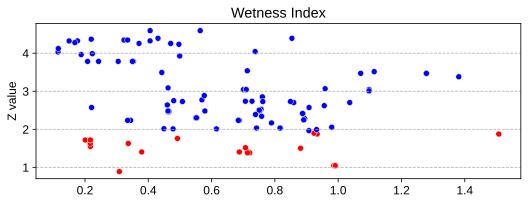

In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 12}
plt.rc('font', **font)

## Create a new column indicating whether P value is less than 0.05
MK_trend['Significant'] = MK_trend['P'] < 0.05

# Define a custom color palette for significant and non-significant Z values
palette = {True: 'blue', False: 'red'}

# Create the swarmplot
plt.figure(figsize=(7.5, 3))
sns.scatterplot(data=MK_trend, x='Wetness_Index', y='Z', hue='Significant', palette=palette, s=36)

plt.legend().remove()

# Add labels and title
plt.xlabel('')
plt.ylabel('Z value')
plt.title('Wetness Index')
plt.grid(axis='y', linestyle='--')

plt.tight_layout()

# plt.savefig('MKTest_WI.jpg', dpi=400)

### PDF Comparison

Sites with long time series available:

US-Ha1 (1991), US-MMS, US-Ton

2001, 2002, 2003 vs 2018, 2019, 2020

In [ ]:
Allsites[Allsites.SiteID=='US-Ton']

,TimeStamp,SiteID,T_air,SW,LW_In,LW_Out,VPD,precipitation,WS,CO2,...,MAP,MAT,Country,Latitude,Longitude,Elevation,Wetness_Index,PFT,Climate,Max_T_air
66428,2001-06-01,US-Ton,25.066,308.007,329.774,-9999.000000,21.847,0.000,2.631,378.411,...,559.0,15.8,USA,38.4309,-120.966,177.0,0.3442,SAV,M,31.47
66429,2001-06-02,US-Ton,19.144,341.148,298.288,-9999.000000,13.116,0.000,2.413,375.770,...,559.0,15.8,USA,38.4309,-120.966,177.0,0.3442,SAV,M,26.17
66430,2001-06-03,US-Ton,18.848,347.083,294.784,-9999.000000,15.601,0.000,2.214,377.492,...,559.0,15.8,USA,38.4309,-120.966,177.0,0.3442,SAV,M,25.84
66431,2001-06-04,US-Ton,20.664,346.732,296.591,-9999.000000,19.320,0.000,2.029,378.615,...,559.0,15.8,USA,38.4309,-120.966,177.0,0.3442,SAV,M,28.96
66432,2001-06-05,US-Ton,20.894,341.031,316.481,-9999.000000,17.434,0.000,2.078,380.443,...,559.0,15.8,USA,38.4309,-120.966,177.0,0.3442,SAV,M,27.87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
69527,2021-09-26,US-Ton,17.727,229.304,298.781,408.876875,8.686,0.000,1.507,394.553,...,559.0,15.8,USA,38.4309,-120.966,177.0,0.3442,SAV,M,25.48
69528,2021-09-27,US-Ton,17.414,219.786,327.866,410.330208,6.274,1.169,2.084,389.660,...,559.0,15.8,USA,38.4309,-120.966,177.0,0.3442,SAV,M,24.82
69529,2021-09-28,US-Ton,17.532,234.162,306.496,399.320208,12.068,0.185,3.033,404.073,...,559.0,15.8,USA,38.4309,-120.966,177.0,0.3442,SAV,M,24.49
69530,2021-09-29,US-Ton,18.784,236.766,287.701,402.691250,16.634,0.000,1.991,400.715,...,559.0,15.8,USA,38.4309,-120.966,177.0,0.3442,SAV,M,26.43


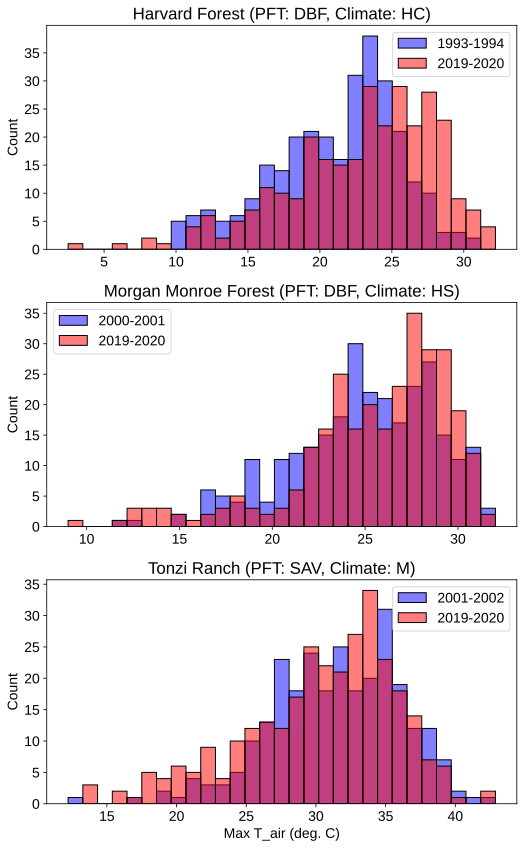

In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# # Define the colors
# blue_color = '#87CEEB'
# red_color =

f, axes = plt.subplots(3,1, figsize=(7.5,12))

################################################################################
data = Allsites[Allsites.SiteID=='US-Ha1']
data['Year'] = data['TimeStamp'].dt.year
data1 = data[(1993 <= data.Year) & (data.Year <= 1994)]
data2 = data[(2019 <= data.Year) & (data.Year <= 2020)]

# Calculate common bin edges
min_val = min(data1['Max_T_air'].min(), data2['Max_T_air'].min())
max_val = max(data1['Max_T_air'].max(), data2['Max_T_air'].max())
bins = np.linspace(min_val, max_val, 30)

z1 = sns.histplot(data=data1, x='Max_T_air', ax=axes[0], color='blue', alpha=0.5, bins=bins, edgecolor='black', label='1993-1994')
z2 = sns.histplot(data=data2, x='Max_T_air', ax=axes[0], color='red', alpha=0.5, bins=bins, edgecolor='black', label='2019-2020')
################################################################################
data = Allsites[Allsites.SiteID=='US-MMS']
data['Year'] = data['TimeStamp'].dt.year
data1 = data[(2000 <= data.Year) & (data.Year <= 2001)]
data2 = data[(2019 <= data.Year) & (data.Year <= 2020)]

# Calculate common bin edges
min_val = min(data1['Max_T_air'].min(), data2['Max_T_air'].min())
max_val = max(data1['Max_T_air'].max(), data2['Max_T_air'].max())
bins = np.linspace(min_val, max_val, 30)

z3 = sns.histplot(data=data1, x='Max_T_air', ax=axes[1], color='blue', alpha=0.5, bins=bins, edgecolor='black', label='2000-2001')
z4 = sns.histplot(data=data2, x='Max_T_air', ax=axes[1], color='red', alpha=0.5, bins=bins, edgecolor='black', label='2019-2020')
################################################################################
data = Allsites[Allsites.SiteID=='US-Ton']
data['Year'] = data['TimeStamp'].dt.year
data1 = data[(2001 <= data.Year) & (data.Year <= 2002)]
data2 = data[(2019 <= data.Year) & (data.Year <= 2020)]

# Calculate common bin edges
min_val = min(data1['Max_T_air'].min(), data2['Max_T_air'].min())
max_val = max(data1['Max_T_air'].max(), data2['Max_T_air'].max())
bins = np.linspace(min_val, max_val, 30)

z5 = sns.histplot(data=data1, x='Max_T_air', ax=axes[2], color='blue', alpha=0.5, bins=bins, edgecolor='black', label='2001-2002')
z6 = sns.histplot(data=data2, x='Max_T_air', ax=axes[2], color='red', alpha=0.5, bins=bins, edgecolor='black', label='2019-2020')
################################################################################



axes[0].legend()
axes[1].legend()
axes[2].legend()

z1.set(xlabel=None, ylabel='Count', title='Harvard Forest (PFT: DBF, Climate: HC)')
z3.set(xlabel=None, ylabel='Count', title='Morgan Monroe Forest (PFT: DBF, Climate: HS)')
z5.set(xlabel='Max T_air (deg. C)', ylabel='Count', title='Tonzi Ranch (PFT: SAV, Climate: M)')


plt.tight_layout()


# plt.savefig('PDF_Temp.jpg', dpi=400)

## Next Steps

hexplot of ET

Do all the correlations site by site, make the CSV files, then use swarmplots. You might find this gives better results in terms of correlation and even tipping points.

the other idea for MAT, MAP, aridity index with scatter plots.  

Different CO2 concentration (e.g. 360-370) and dynamics!


### Test


In [ ]:
# Set the font to Liberation Sans
font = {'family': 'Liberation Sans', 'weight': 'normal', 'size': 14}
plt.rc('font', **font)

# Define the muted blue color and dark blue edge color
blue_color = '#87CEEB'  # Lighter muted blue
edge_color = '#003366'  # Dark blue

f, axes = plt.subplots(3,3, figsize=(18,12))

################################################################################
data = Allsites[Allsites.SiteID=='CA-Ca1']

z1 = sns.scatterplot(data=data, x= 'T_air', y= 'GPP_day', ax=axes[0,0], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.SiteID=='CA-Cbo']

z2 = sns.scatterplot(data=data, x= 'T_air', y= 'GPP_day', ax=axes[0,1], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.SiteID=='US-Mpj']

z3 = sns.scatterplot(data=data, x= 'T_air', y= 'GPP_day', ax=axes[0,2], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.SiteID=='US-Wjs']

z4 = sns.scatterplot(data=data, x= 'T_air', y= 'GPP_day', ax=axes[1,0], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.SiteID=='US-Rms']

z5 = sns.scatterplot(data=data, x= 'T_air', y= 'GPP_day', ax=axes[1,1], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.SiteID=='US-Rws']

z6 = sns.scatterplot(data=data, x= 'T_air', y= 'GPP_day', ax=axes[1,2], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.SiteID=='US-Seg']

z7 = sns.scatterplot(data=data, x= 'T_air', y= 'GPP_day', ax=axes[2,0], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.SiteID=='US-Tw2']

z8 = sns.scatterplot(data=data, x= 'T_air', y= 'GPP_day', ax=axes[2,1], color=blue_color, edgecolor=edge_color)
################################################################################
data = Allsites[Allsites.SiteID=='US-Myb']

z9 = sns.scatterplot(data=data, x= 'T_air', y= 'GPP_day', ax=axes[2,2], color=blue_color, edgecolor=edge_color)


# Set x and y axis ticks
for ax in axes.flat:
    ax.tick_params(axis='x', which='both', bottom=True, top=False)
    ax.tick_params(axis='y', which='both', left=True, right=False)
    ax.set_xticklabels(ax.get_xticklabels(), rotation=0, ha='center')
    ax.set_yticklabels(ax.get_yticklabels(), rotation=0, ha='right')

z1.set(xlabel=None, ylabel='GPP', title='Evergreen Needleleaf Forests')
z2.set(xlabel=None, ylabel=None, title='Deciduous Broadleaf Forests')
z3.set(xlabel=None, ylabel=None, title='Woody Savannas')
z4.set(xlabel=None, ylabel='GPP', title='Savannas')
z5.set(xlabel=None, ylabel=None, title='Closed Shrublands')
z6.set(xlabel=None, ylabel=None, title='Open Shrublands')
z7.set(xlabel='Air Temperature', ylabel='GPP', title='Grasslands')
z8.set(xlabel='Air Temperature', ylabel=None, title='Cropland')
z9.set(xlabel='Air Temperature', ylabel=None, title='Wetland')


# Remove extra lines in the axes
sns.despine()
plt.tick_params(bottom=True, left=True)

sns.set(font_scale=1.25,style='white')
plt.tight_layout()


# plt.savefig('Tipping_Poit_Test.jpg', dpi=400)

In [ ]:
os.chdir('/content/gdrive/MyDrive/Postdoc Research/RS Flux Feature Analysis/Flux Data')

Ton = pd.read_csv('US_Ton_HH.csv', index_col=None, header=0)

In [ ]:
Ton1 = Ton[['TIMESTAMP_START', 'TA_F', 'VPD_F', 'GPP_DT_VUT_REF']]

In [ ]:
Ton1.columns = ['Time', 'TA', 'VPD', 'GPP']

In [ ]:
Ton1['Time'] = pd.to_datetime(Ton1['Time'], format='%Y%m%d%H%M')

In [ ]:
Ton2 = Ton1[(Ton1['Time'].dt.strftime('%H%M') >= '0900') & (Ton1['Time'].dt.strftime('%H%M') <= '1430')]

In [ ]:
Ton2['Date'] = Ton2['Time'].dt.date

In [ ]:
Ton2

,Time,TA,VPD,GPP,Date
18,2001-01-01 09:00:00,7.496,4.177,6.52587,2001-01-01
19,2001-01-01 09:30:00,7.901,4.291,7.27470,2001-01-01
20,2001-01-01 10:00:00,8.307,4.405,8.16134,2001-01-01
21,2001-01-01 10:30:00,10.032,5.538,8.53737,2001-01-01
22,2001-01-01 11:00:00,11.756,6.671,8.91986,2001-01-01
...,...,...,...,...,...
368137,2021-12-31 12:30:00,8.080,1.424,5.79042,2021-12-31
368138,2021-12-31 13:00:00,9.330,3.872,6.26490,2021-12-31
368139,2021-12-31 13:30:00,9.800,6.128,6.11149,2021-12-31
368140,2021-12-31 14:00:00,9.940,6.192,5.94703,2021-12-31


In [ ]:
Ton5 = Ton2[(Ton2['TA'] >= 39)]

In [ ]:
Ton5

,Time,TA,VPD,GPP,Date
6701,2001-05-20 14:30:00,39.022,31.856,8.37938,2001-05-20
6747,2001-05-21 13:30:00,39.512,24.623,9.46971,2001-05-21
6748,2001-05-21 14:00:00,40.176,26.435,9.11724,2001-05-21
6749,2001-05-21 14:30:00,40.626,29.313,8.61677,2001-05-21
7229,2001-05-31 14:30:00,39.060,60.616,6.36120,2001-05-31
...,...,...,...,...,...
359785,2021-07-10 12:30:00,39.650,62.959,1.40870,2021-07-10
359786,2021-07-10 13:00:00,40.880,67.008,1.26479,2021-07-10
359787,2021-07-10 13:30:00,40.790,66.781,1.24831,2021-07-10
359788,2021-07-10 14:00:00,41.450,69.352,1.15101,2021-07-10


In [ ]:
max_ta_per_day = Ton2.groupby('Date')['TA'].max()
sum_gpp_per_day = Ton2.groupby('Date')['GPP'].sum()

Ton3 = pd.DataFrame({'Max_TA': max_ta_per_day, 'Sum_GPP': sum_gpp_per_day})

In [ ]:
Ton3

,Max_TA,Sum_GPP
Date,,
2001-01-01,16.227,98.89500
2001-01-02,17.290,99.43346
2001-01-03,16.194,99.92046
2001-01-04,16.913,100.18704
2001-01-05,15.835,100.37090
...,...,...
2021-12-27,6.982,48.35065
2021-12-28,6.921,79.56193
2021-12-29,8.930,56.26780


In [ ]:
upper_GPP = Ton2['GPP'].quantile(0.975)
lower_GPP = Ton2['GPP'].quantile(0.025)

Ton4 = Ton2[(Ton2['GPP'] <= upper_GPP) & (Ton2['GPP'] >= lower_GPP)]

Text(0, 0.5, 'GPP')

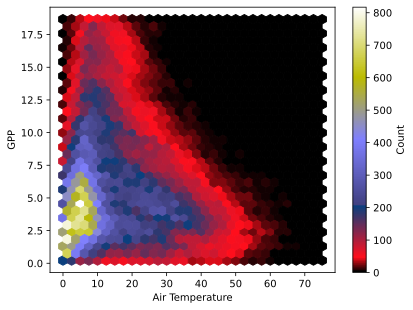

In [ ]:
data = Ton4

hexbin_plot = plt.hexbin(data=data, x= 'VPD', y= 'GPP', gridsize=30, cmap='gist_stern')
plt.colorbar(hexbin_plot, label='Count')

plt.xlabel('Air Temperature')
plt.ylabel('GPP')

# plt.savefig('TA_GPP.jpg', dpi=400)

<Axes: xlabel='TA', ylabel='GPP'>

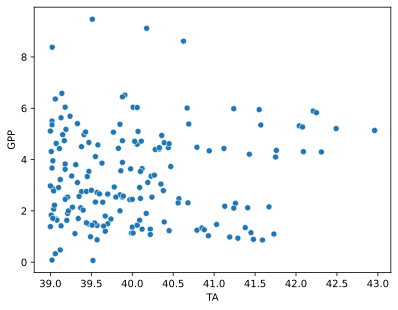

In [ ]:
data = Ton5

sns.scatterplot(data=data, x= 'TA', y= 'GPP')

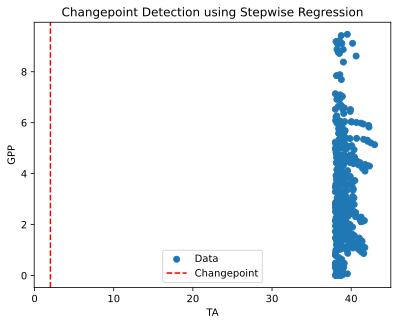

KeyError: 2

In [ ]:

import statsmodels.api as sm


# Assuming Ton5 is your DataFrame with columns 'GPP' and 'TA'
# Replace 'GPP' and 'TA' with your actual column names

# Fit a stepwise regression model
def stepwise_regression(df):
    results = []
    for i in range(1, len(df)):
        model = sm.OLS(df['GPP'][:i], sm.add_constant(df['TA'][:i])).fit()
        results.append((i, model.aic))

    return results

# Run stepwise regression
results = stepwise_regression(Ton5)

# Find the point with minimum AIC
best_point, _ = min(results, key=lambda x: x[1])

# Plot the results
plt.scatter(Ton5['TA'], Ton5['GPP'], label='Data')
plt.axvline(x=best_point, color='r', linestyle='--', label='Changepoint')
plt.title('Changepoint Detection using Stepwise Regression')
plt.xlabel('TA')
plt.ylabel('GPP')
plt.legend()
plt.show()

print(f'Changepoint detected at TA = {Ton5["TA"][best_point]}')

## Paper Revision

In [ ]:
# Get unique SiteID values
unique_site_ids = Allsites['SiteID'].unique()

# List to store the results
results = []

# Iterate over each unique SiteID
for site_id in unique_site_ids:
    # Filter the DataFrame for the current SiteID
    subset_df = Allsites[Allsites['SiteID'] == site_id]

    # Sort subset by GPP in descending order
    sorted_subset = subset_df.sort_values(by='GPP_day', ascending=False)

    # Calculate the number of top 10% records
    number_of_records = len(sorted_subset)
    top_10_percent_count = max(1, int(number_of_records * 0.10))

    # Select the top 10% of records
    top_10_percent_df = sorted_subset.head(top_10_percent_count)

    # Calculate the average of T_air for these records
    Opt_T_air = top_10_percent_df['T_air'].mean()

    # Calculate the weighted average of T_air
    W_avg_T_air = (subset_df.T_air * subset_df.GPP_day).sum() / subset_df.GPP_day.sum()

    # Append to results
    results.append({'SiteID': site_id, 'Opt_T_air': Opt_T_air, 'W_avg_T_air': W_avg_T_air})

# Create a new DataFrame from the results
T_air_df = pd.DataFrame(results)

In [ ]:
T_air_df

,SiteID,Opt_T_air,W_avg_T_air
0,US-HB1,26.499294,23.252470
1,US-ICh,11.800040,9.822544
2,US-Seg,22.492756,19.797728
3,US-xKA,24.226640,22.578976
4,CA-ARB,15.169293,13.943818
...,...,...,...
103,US-KLS,23.535767,20.896613
104,US-Me6,14.537288,12.443653
105,US-Mo1,22.363649,20.235787
106,US-NC3,25.058849,21.746241


In [ ]:
from sklearn.metrics import mean_squared_error, r2_score
from math import sqrt
from scipy.stats import linregress

In [ ]:
rmse = sqrt(mean_squared_error(T_air_df.W_avg_T_air, T_air_df.Opt_T_air))

r2 = r2_score(T_air_df.W_avg_T_air, T_air_df.Opt_T_air)

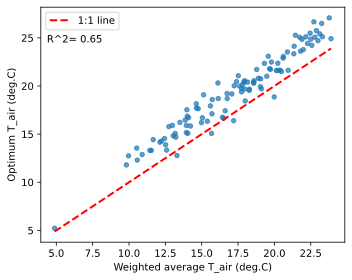

In [ ]:
# Create scatter plot with 1:1 line
fig, ax = plt.subplots(figsize=(5, 4))

plt.scatter(T_air_df.W_avg_T_air, T_air_df.Opt_T_air, alpha=0.7, s=20)
plt.plot([min(T_air_df.W_avg_T_air), max(T_air_df.W_avg_T_air)],
         [min(T_air_df.W_avg_T_air), max(T_air_df.W_avg_T_air)], '--', color='red', linewidth=2, label='1:1 line')

# Add labels and title
plt.xlabel('Weighted average T_air (deg.C)')
plt.ylabel('Optimum T_air (deg.C)')
plt.title('')

# Add R-squared and RMSE annotations
plt.annotate(f'R^2= {r2:.2f}', xy=(0.02, 0.85), xycoords='axes fraction', fontsize=10)

# Add legend
plt.legend()

plt.tight_layout()


# plt.savefig('Optimum_vs_average_T_air.jpg', dpi=400)

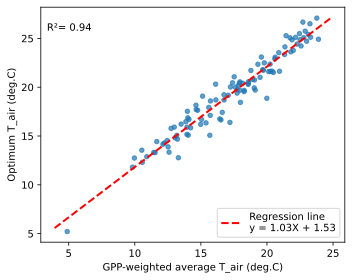

In [ ]:
# Perform linear regression
slope, intercept, r_value, p_value, std_err = linregress(T_air_df.W_avg_T_air, T_air_df.Opt_T_air)

# Create scatter plot
fig, ax = plt.subplots(figsize=(5, 4))
plt.scatter(T_air_df.W_avg_T_air, T_air_df.Opt_T_air, alpha=0.7, s=20)

# Plot regression line
x_vals = np.array(ax.get_xlim())
y_vals = intercept + slope * x_vals
plt.plot(x_vals, y_vals, '--', color='red', linewidth=2, label=f'Regression line\ny = {slope:.2f}X + {intercept:.2f}')

# Add labels and title
plt.xlabel('GPP-weighted average T_air (deg.C)')
plt.ylabel('Optimum T_air (deg.C)')
plt.title('')

# Add R-squared annotation
plt.annotate(f'R²= {r_value**2:.2f}', xy=(0.02, 0.9), xycoords='axes fraction', fontsize=10)

# Add legend
plt.legend()

plt.tight_layout()

# Save or show the plot
# plt.savefig('Optimum_vs_average_T_air.jpg', dpi=400)